# Classify a hiprfish image with hierarchical clustering
## Setup

In [1]:
import glob
import sys
import os
import gc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import yaml
import re
from collections import defaultdict
import aicspylibczi as aplc
from skimage.registration import phase_cross_correlation
from tqdm import tqdm
from scipy.cluster import hierarchy
from scipy.spatial.distance import squareform
import umap
import math

In [3]:
cluster = ''
workdir = '/workdir/bmg224/manuscripts/mgefish/code/bmg_plasmids_imaging/agglomerative_clustering'
os.chdir(cluster + workdir)
os.getcwd()

'/local/workdir/bmg224/manuscripts/mgefish/code/bmg_plasmids_imaging/agglomerative_clustering'

In [4]:
config_fn = "config_240107.yaml"  # relative path to config file from workdir

with open(config_fn, "r") as f:
    config = yaml.safe_load(f)

In [5]:
%load_ext autoreload
%autoreload 2

sys.path.append(config['pipeline_path'] + '/' + config['functions_path'])
import fn_general_use as fgu
import image_plots as ip
import segmentation_func as sf
import fn_hiprfish_classifier as fhc
import fn_spectral_images as fsi



## Plot references

In [7]:
def sum_normalize_ref(ref_spec):
    ref_sum_norm = []
    for r in ref_spec:
        r_ = r - np.min(r, axis=1)[:, None]
        ref_sum_norm.append(r_ / np.sum(r_, axis=1)[:, None])
    return [np.mean(r, axis=0) for r in ref_sum_norm]


def get_reference_spectra(barcodes, bc_len):
    ref_dir = "/workdir/bmg224/manuscripts/mgefish/data/unused/fig_5/HiPRFISH_reference_spectra"
    fmt = "08_18_2018_enc_{}_avgint.csv"
    # if bc_len == 5:
    barcodes_str = [str(bc).zfill(5) for bc in barcodes]
    # barcodes_str = [str(bc).zfill(7) for bc in barcodes]
    # barcodes_10bit = [bc[0] + '0' + bc[1:4] + '00' + bc[4:] for bc in barcodes_str]
    barcodes_10bit = [bc[0] + "0" + bc[1] + "0000" + bc[2:] for bc in barcodes_str]
    barcodes_b10 = [int(str(bc), 2) for bc in barcodes_10bit]
    st = 32
    en = 32 + 57
    ref_avgint_cols = [i for i in range(st, en)]

    ref_spec = []
    for bc in barcodes_b10:
        fn = cluster + "/" + ref_dir + "/" + fmt.format(bc)
        ref = pd.read_csv(fn, header=None)
        ref = ref[ref_avgint_cols].values
        ref_spec.append(ref)
    return ref_spec


# Get reference spectra
probe_design_dir = (
    "/workdir/bmg224/manuscripts/mgefish/data/HiPRFISH_probe_design"
)
probe_design_fn = probe_design_dir + "/welch2016_5b_distant_v4_doubleflank.csv"
probe_design = pd.read_csv(probe_design_fn)
barcodes = probe_design["code"].unique()
barcode_length = len(str(np.max(barcodes)))
ref_spec = get_reference_spectra(barcodes, barcode_length)
sci_names = [
    probe_design.loc[probe_design["code"] == bc, "sci_name"].unique()[0]
    for bc in barcodes
]
weights_sum_norm = sum_normalize_ref(ref_spec)

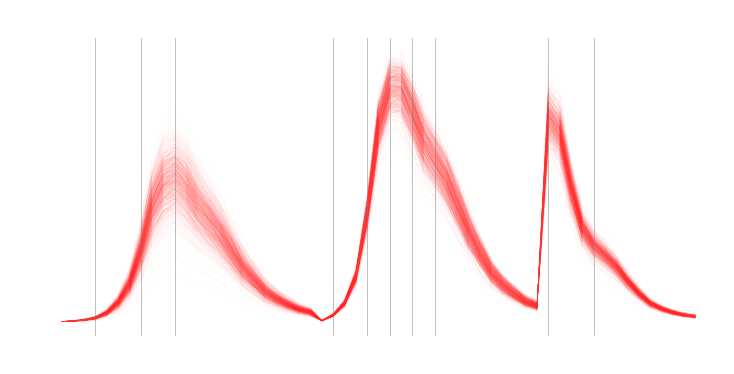

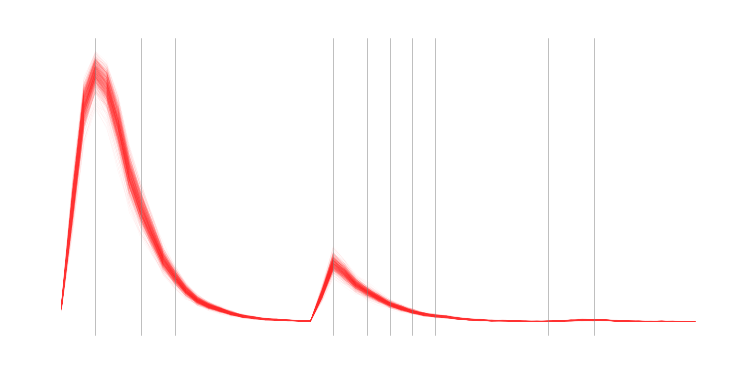

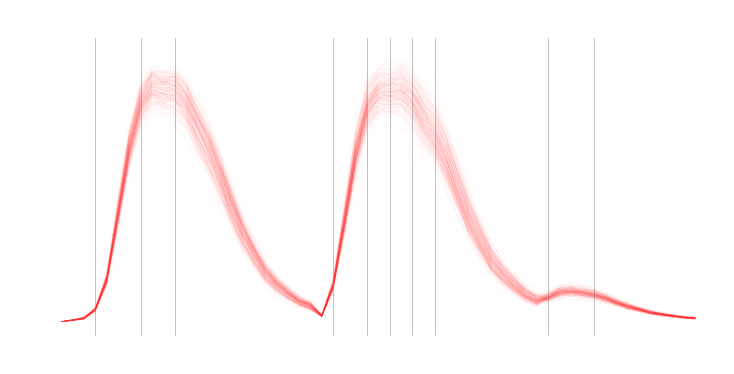

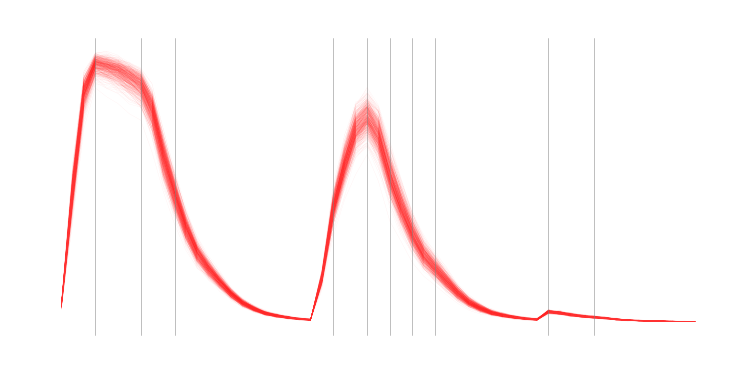

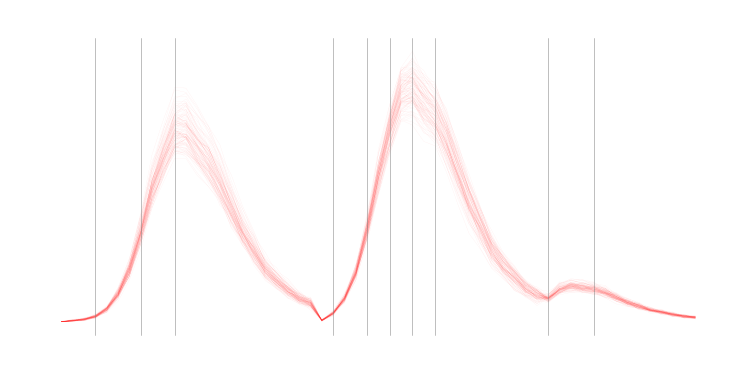

...

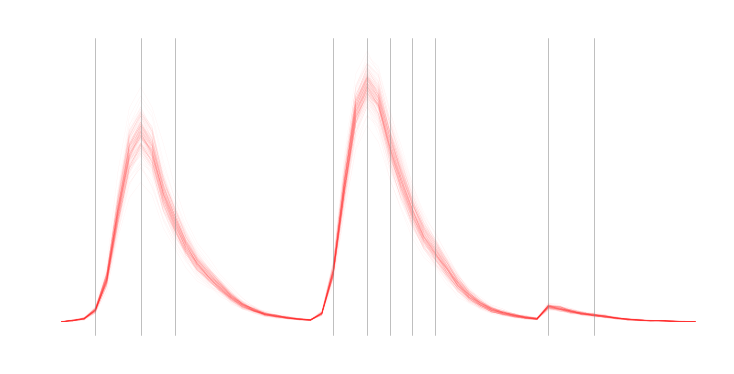

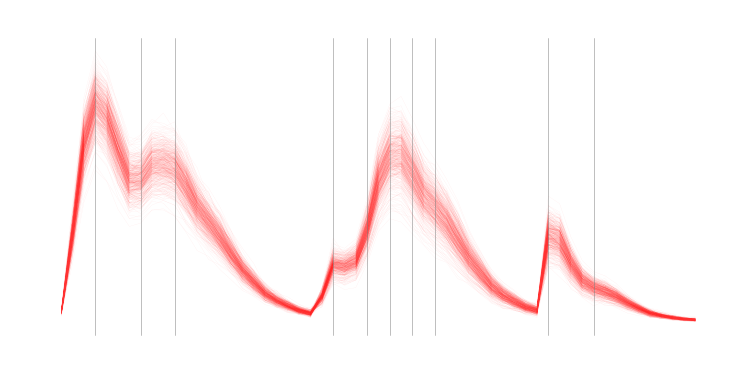

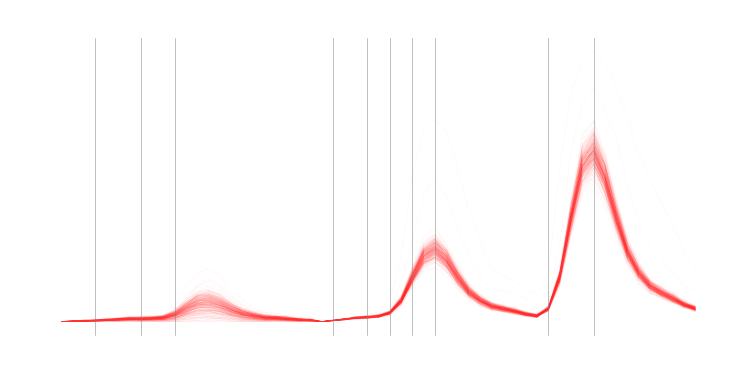

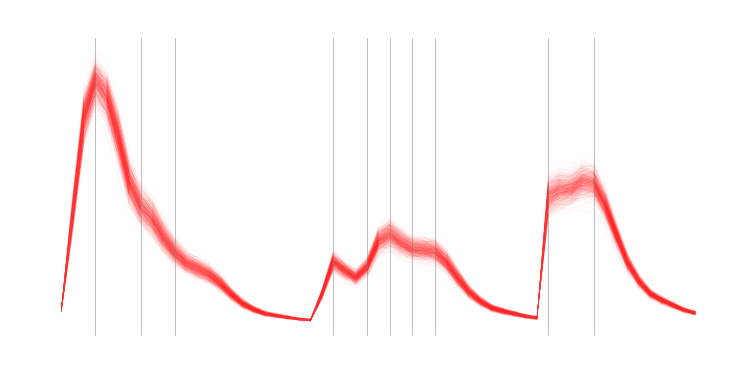

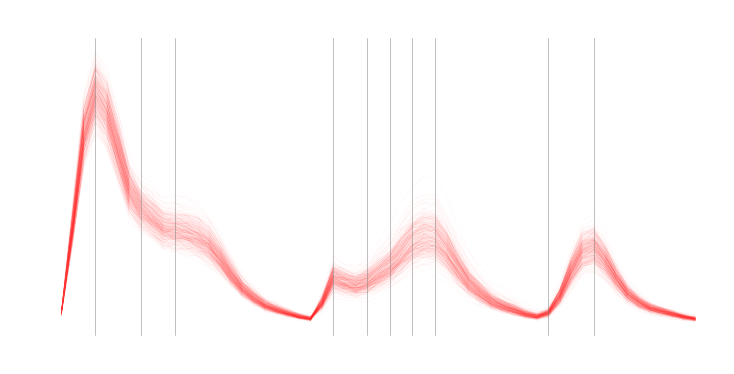

In [10]:
spec_dims = (10, 5)

for s, name in zip(ref_spec, sci_names):
    fig, ax = ip.general_plot(dims=spec_dims, col='w')
    fsi.plot_cell_spectra(ax, s, {"lw": 0.2, "alpha": 0.1, "color": "r"})
    ax.set_title(name, color='w')

    ylim = ax.get_ylim()

    xs = [3, 7, 10, 24, 27, 29, 31, 33, 43, 47]
    for x in xs:
        ax.plot([x, x], ylim, color=(0.5, 0.5, 0.5), lw=0.5)

## FIlenames

In [136]:
# Get filenames from directories
raw_dir = config["data_dir"] + "/*.czi"
# raw_dir = config["data_dir"] + "/*" + config["laser_regex"]
fns = glob.glob(raw_dir)
fns_base = [os.path.split(f)[1] for f in fns]
group_names = [re.sub("_2023\w+.czi", "", s) for s in fns_base]
# print('HERE-->', shifts_fns)
group_names = np.sort(np.unique(group_names))
m_size = group_names.shape[0]
dict_group_czifns_all = defaultdict(list)
for g in group_names:
    for s in fns:
        if g in s:
            dict_group_czifns_all[g].append(s)
dict_group_czifns_all = {g: sorted(s) for g, s in dict_group_czifns_all.items()}
dict_group_czifns_all

{'2023_11_22_newplasmid_sample_bmg_fov_01': ['../../../data/bmg_plasmid/2023_11_22_newplasmid/2023_11_22_newplasmid_sample_bmg_fov_01_2023_11_22__04_10_42.czi',
  '../../../data/bmg_plasmid/2023_11_22_newplasmid/2023_11_22_newplasmid_sample_bmg_fov_01_2023_11_22__04_11_44.czi',
  '../../../data/bmg_plasmid/2023_11_22_newplasmid/2023_11_22_newplasmid_sample_bmg_fov_01_2023_11_22__04_12_46.czi',
  '../../../data/bmg_plasmid/2023_11_22_newplasmid/2023_11_22_newplasmid_sample_bmg_fov_01_2023_11_22__04_13_52.czi',
  '../../../data/bmg_plasmid/2023_11_22_newplasmid/2023_11_22_newplasmid_sample_bmg_fov_01_2023_11_22__04_13_52_airy.czi',
  '../../../data/bmg_plasmid/2023_11_22_newplasmid/2023_11_22_newplasmid_sample_bmg_fov_01_2023_11_22__04_17_37.czi'],
 '2023_11_22_newplasmid_sample_bmg_fov_02': ['../../../data/bmg_plasmid/2023_11_22_newplasmid/2023_11_22_newplasmid_sample_bmg_fov_02_2023_11_22__04_26_38.czi',
  '../../../data/bmg_plasmid/2023_11_22_newplasmid/2023_11_22_newplasmid_sample_bm

In [97]:
# input_table = pd.read_csv('../' + config['input_table_fn'])
# input_table

,SAMPLE,IMAGES,SAMPLING_TIME,SAMPLING_DAY_REFERENCE,MOUSE,TREATMENT,CALIBRATION,REFERENCE,CALIBRATION_FILENAME,REFERENCE_FOLDER,SPC,DIMENSION,ZSLICE,PROBEDESIGN,DESIGN_ID,SIZELIMIT,MARKER_X,MARKER_Y
0,.,plasmid_mefE_host_association_fov_07,0,0,0,0,F,T,0,../../../../outputs/fig_5/2023_02_09_hiprmega/...,2000,2,-1,../../../../data/fig_5/HiPRFISH_probe_design_o...,welch2016,200,0,0
1,.,plasmid_mefE_host_association_fov_02,0,0,0,0,F,T,0,../../../../outputs/fig_5/2023_02_09_hiprmega/...,2000,2,-1,../../../../data/fig_5/HiPRFISH_probe_design_o...,welch2016,200,0,0


In [137]:
sn = '2023_11_22_newplasmid_sample_bmg_fov_04'
# sn = input_table['IMAGES'][0]
# sn

In [138]:
output_dir = config['output_dir'] + '/' + sn

stack_dir = output_dir + '/stacks'
props_dir = output_dir + '/props'
segs_dir = output_dir + '/segs'
spec_dir = output_dir + '/spectra'
clust_dir = output_dir + '/clust'

bn = sn + '_M_{m}'

stack_fn = stack_dir + '/' + bn + '_stack.npy'
props_fn = props_dir + '/' + bn + '_props.csv'
seg_fn = segs_dir + '/' + bn + '_seg.npy'
spec_fn = spec_dir + '/' + bn + '_spec.yaml'
clust_fn = clust_dir + '/' + bn + '_clust.yaml'



In [139]:
stack_fns = glob.glob(stack_fn.format(m='*'))
Ms = sorted([re.findall('(?<=M_)\d+', fn)[0] for fn in stack_fns])
Ms

['0', '1', '2', '3']

## Automated ID cluster

In [140]:
# Classification 
dict_m_cl_sciname = {}
dict_sciname_count = defaultdict(lambda:0)
dict_sciname_spec = defaultdict(list)

for m in Ms:
    # if not os.path.exists(out_bn + '.png'):
    print('----------Tile:', m,'--------------')
    # Load files
    stack = np.load(stack_fn.format(m=m))    
    props = pd.read_csv(props_fn.format(m=m))    
    seg = np.load(seg_fn.format(m=m))  


    with open(spec_fn.format(m=m), 'r') as f:
        dict_lab_spec = yaml.unsafe_load(f)
        # spec = yaml.load(f, Loader=Loader)
    with open(clust_fn.format(m=m), 'r') as f:
        dict_lab_clust = yaml.unsafe_load(f)



    # Set up output dir
    classif_dir = output_dir + '/clust_classif'
    if not os.path.exists(classif_dir): 
        os.makedirs(classif_dir)
        print("made dir", classif_dir)

    bn = sn + '_M_{m}'

    classif_bn = classif_dir + '/' + bn + '_clust_classif'
    out_bn = classif_bn.format(m=m)



    # Get matrix of differences between clusters
    dict_cl_spec = defaultdict(list)
    for l, cl in dict_lab_clust.items():
        dict_cl_spec[cl].append(dict_lab_spec[l])

    dict_cl_specmean = {cl: np.mean(s, axis=0) for cl, s in dict_cl_spec.items()}
    dict_cl_specnorm = {cl: s / np.sum(s) for cl, s in dict_cl_specmean.items()}

    n_clust = len(dict_cl_specnorm)
    n_chan = dict_cl_specnorm[cl].shape[0]
    diff_mat = np.zeros((n_clust,n_clust,n_chan))
    for i, s_i in enumerate(dict_cl_specnorm.values()):
        for j, s_j in enumerate(dict_cl_specnorm.values()):
            diff_mat[i,j,:] = s_i - s_j


    # Get matrix of differences between reference spectra
    n_ref = len(weights_sum_norm)
    ref_dist_mat = np.zeros((n_ref, n_ref, n_chan))
    for i, s_i in enumerate(weights_sum_norm):
        for j, s_j in enumerate(weights_sum_norm):
            ref_dist_mat[i,j,:] = s_i - s_j



    # Pick the nearest reference difference for each cluster difference 
    cl_ref_mat = np.zeros((n_clust,n_clust,2))
    for i in range(n_clust):
        for j in range(n_clust):
            # if j > i:
            s_diff = diff_mat[i,j,:]
            dist = 1e10
            k_l = [n_ref,n_ref]
            for k in range(n_ref):
                for l in range(n_ref):
                    ref_diff = ref_dist_mat[k,l,:]
                    dist_ = fhc.channel_cosine_intensity_allonev2(s_diff, ref_diff)
                    if dist_ < dist:
                        dist = dist_
                        k_l[:] = [k,l]
            cl_ref_mat[i,j,:] = k_l



    # Write the cluster classification to variable
    dict_cl_sciname = {}
    for i, cl in enumerate(dict_cl_specnorm.keys()):
        cl_ref = cl_ref_mat[i,:,0]
        ref_i, counts = np.unique(cl_ref, return_counts=True)
        mx_i = np.argwhere(counts == np.max(counts))[0][0]
        dict_cl_sciname[cl] = sci_names[int(ref_i[mx_i])]

    dict_m_cl_sciname[m] = dict_cl_sciname


    # Write spectra to variable
    for cl, scn in dict_cl_sciname.items():
        dict_sciname_spec[scn] += [dict_cl_specmean[cl]]


    # Count cells for each classification
    for cl, sciname in dict_cl_sciname.items():
        count_ = len(dict_cl_spec[cl])
        dict_sciname_count[sciname] += count_






----------Tile: 0 --------------
made dir ../../../outputs/bmg_plasmids_imaging/2023_11_22_newplasmid/agglomerative_cluster/2023_11_22_newplasmid_sample_bmg_fov_04/clust_classif
----------Tile: 1 --------------
----------Tile: 2 --------------
----------Tile: 3 --------------


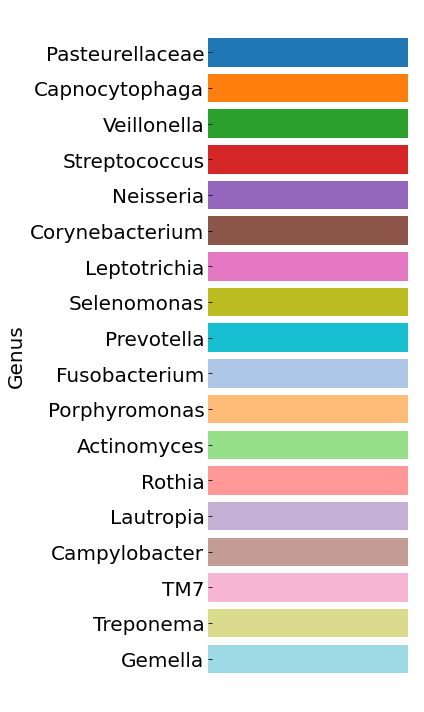

In [146]:
classif_plots_dir = output_dir + '/classif_plots_auto'
if not os.path.exists(classif_plots_dir): 
    os.makedirs(classif_plots_dir)
    print("made dir", classif_plots_dir)



# # Create a color dictionary for taxa
# scn_count = list(dict_sciname_count.values())
# scinames = list(dict_sciname_count.keys())
# scinames_sort = [x for _, x in sorted(zip(scn_count, scinames))][::-1]
scinames_sort = [
    'Pasteurellaceae',
    'Capnocytophaga',
    'Veillonella',
    'Streptococcus',
    'Neisseria',
    'Corynebacterium',
    'Leptotrichia',
    'Selenomonas',
    'Prevotella',
    'Fusobacterium',
    'Porphyromonas',
    'Actinomyces',
    'Rothia',
    'Lautropia',
    'Campylobacter',
    'TM7',
    'Treponema',
    'Gemella'
    ]

colors = list(plt.get_cmap('tab20').colors)
colors.pop(14)
colors.pop(14)
colors_sort = [colors[i] for i in np.arange(0,18,2, dtype=int)]
colors_sort += [colors[i] for i in np.arange(1,18,2, dtype=int)]
dict_sciname_col = dict(zip(scinames_sort, colors_sort))


colors_countsort = [dict_sciname_col[sciname] for sciname in scinames_sort]
ip.taxon_legend(scinames_sort, colors_countsort)
ip.save_png_pdf(classif_plots_dir + '/' + sn + '_taxon_legend')

In [144]:
hipr_raw_fn = dict_group_czifns_all[sn][0]
czi_hipr = aplc.CziFile(hipr_raw_fn)

for n in czi_hipr.meta.iter():
    if 'Scaling' in n.tag:
        if 'X' in n.tag:
            res_hipr = float(n.text)
res_hipr_umpix = res_hipr * 1e6
print('HiPR m/pix',res_hipr_umpix)

HiPR m/pix 0.05990374007588672


----------Tile: 0 --------------


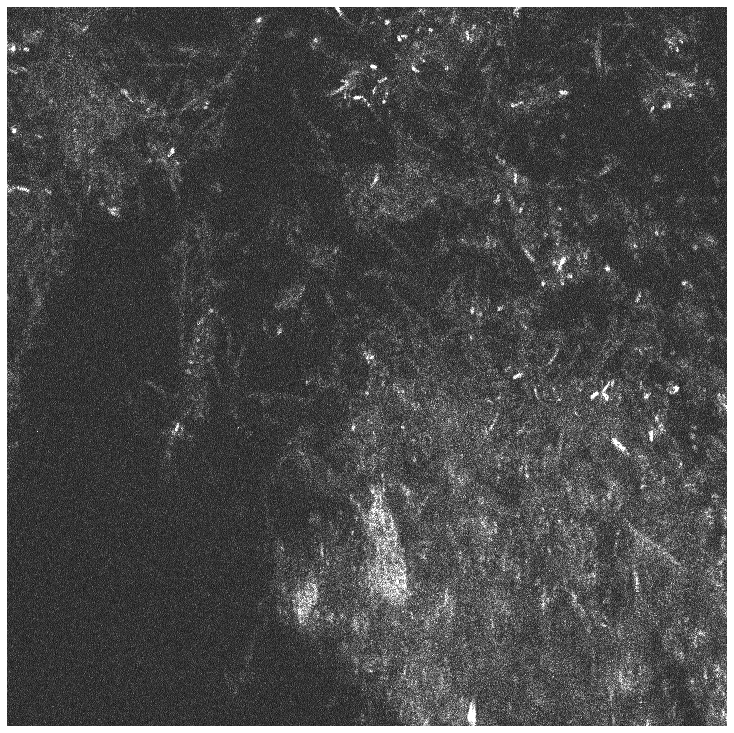

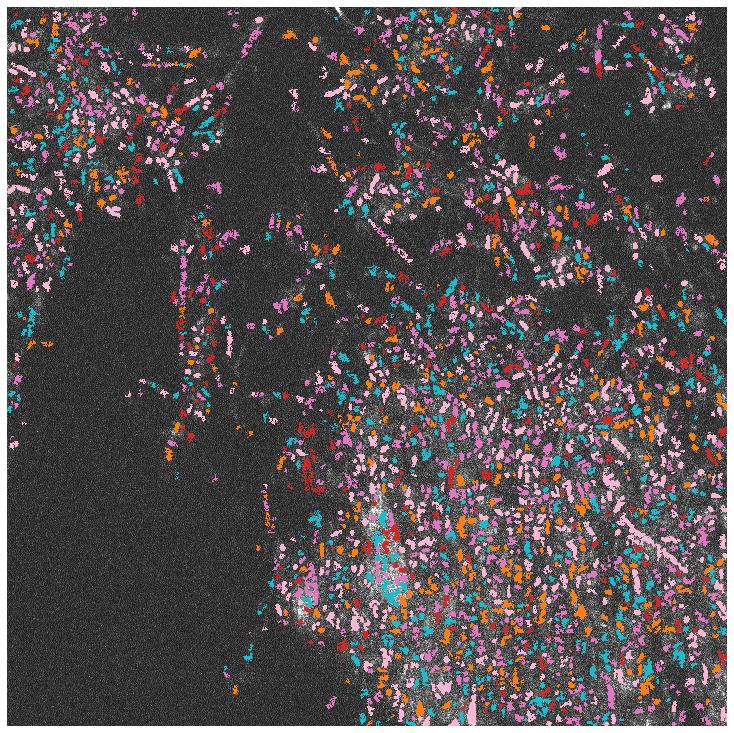

----------Tile: 1 --------------


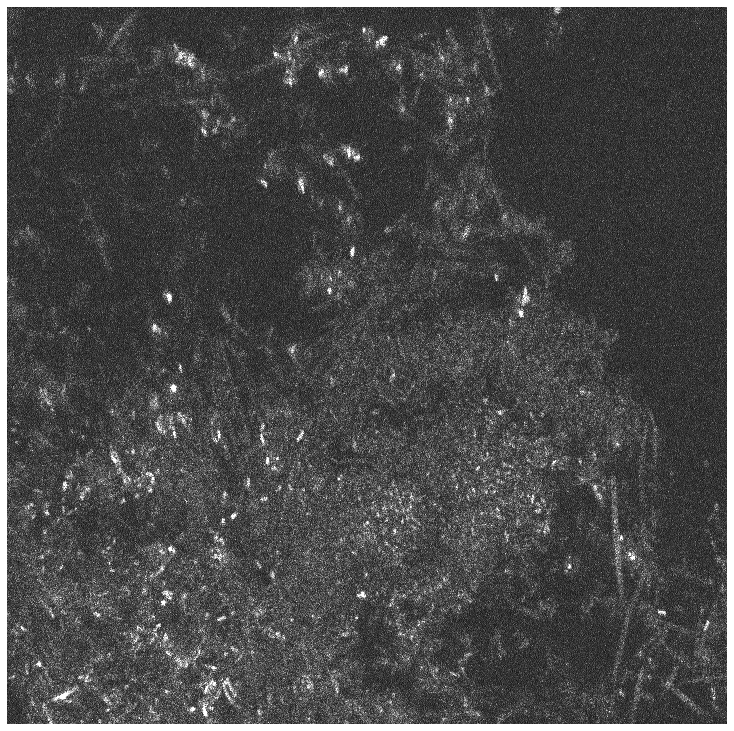

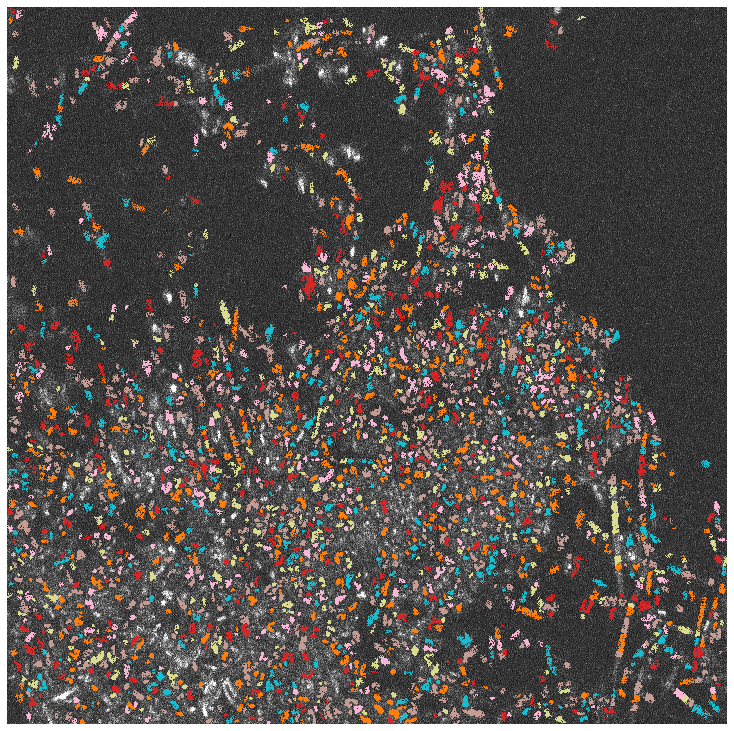

----------Tile: 2 --------------


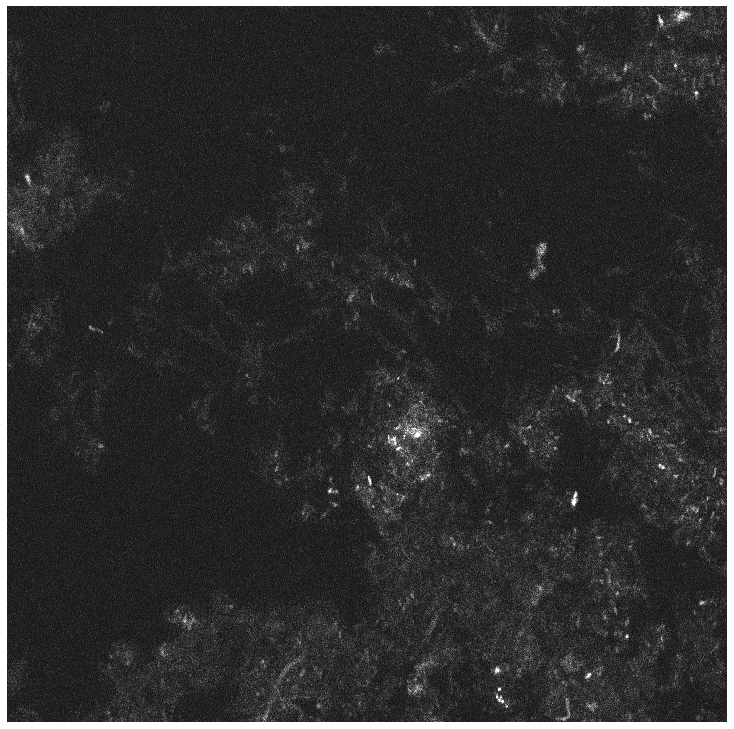

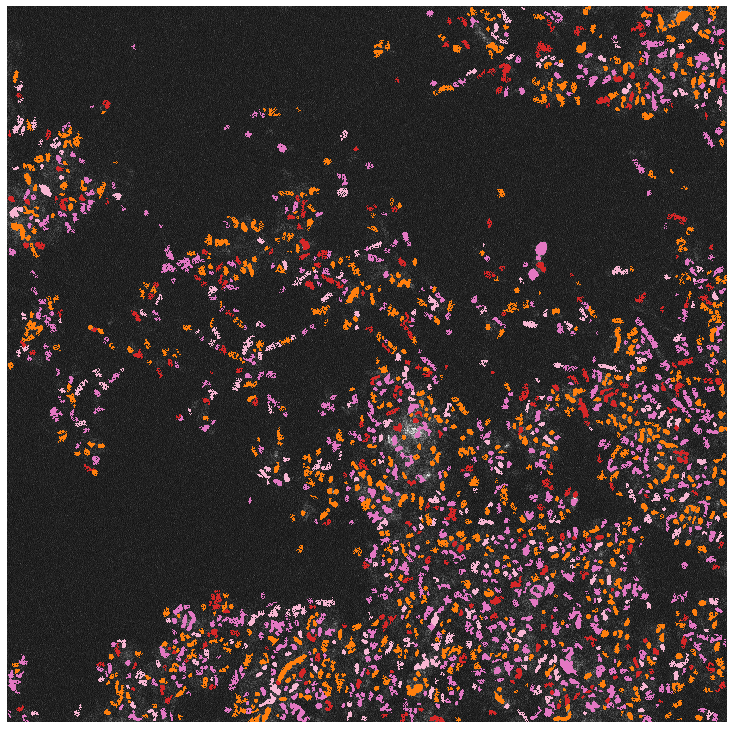

----------Tile: 3 --------------


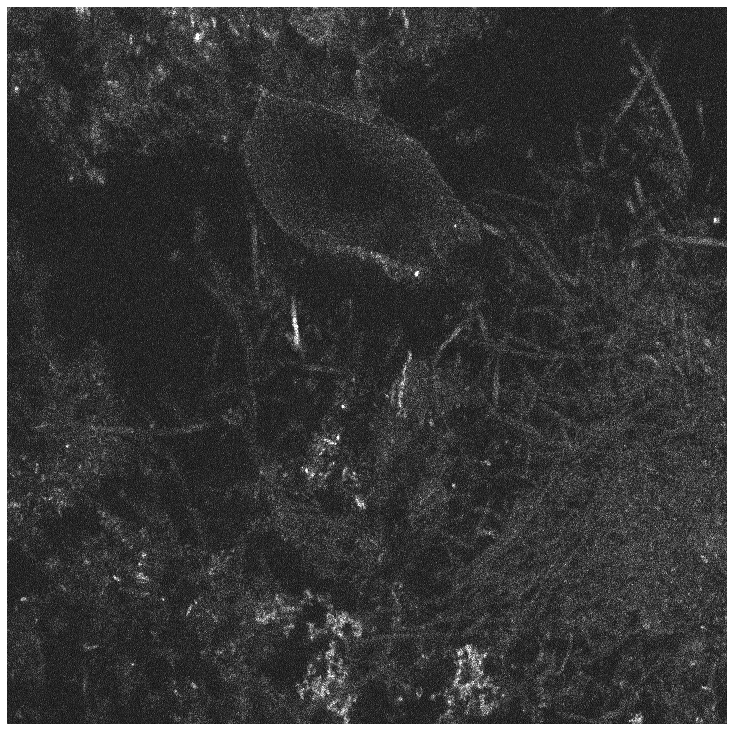

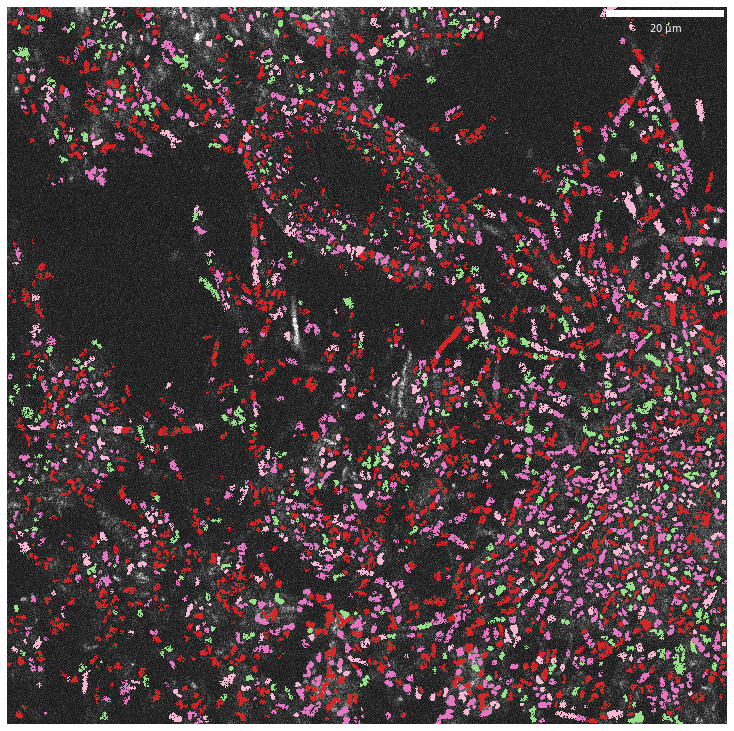

In [149]:
# Plot the classifications
imin = 10
resolution = res_hipr_umpix

for m in Ms:
    # if not os.path.exists(out_bn + '.png'):
    print('----------Tile:', m,'--------------')
    # Load files
    stack = np.load(stack_fn.format(m=m))    
    props = pd.read_csv(props_fn.format(m=m))    
    seg = np.load(seg_fn.format(m=m))  


    with open(spec_fn.format(m=m), 'r') as f:
        dict_lab_spec = yaml.unsafe_load(f)
        # spec = yaml.load(f, Loader=Loader)
    with open(clust_fn.format(m=m), 'r') as f:
        dict_lab_clust = yaml.unsafe_load(f)



    # Set up output dir


    bn = sn + '_M_{m}'

    classif_bn = classif_plots_dir + '/' + bn + '_classif'
    out_bn = classif_bn.format(m=m)

    
    dict_cl_sciname = dict_m_cl_sciname[m]
    
    
    # Plot grayscale image
    im_sum = np.sum(stack, axis=2)
    mx = np.max(im_sum) * 0.3
    mn = np.min(im_sum)
    im_norm = np.clip(im_sum,mn,mx)
    im_norm = (im_norm - mn) / (mx - mn)
    im_rgb = im_norm[:,:,None] * np.array([1,1,1])[None,:]
    fig, ax, cbar = ip.plot_image(im_rgb, im_inches=imin)
    plt.show()
    plt.close()
    
    
    # Plot RGB of classif
    labels = list(dict_lab_clust.keys())
    im_rgb = im_norm[:,:,None] * np.array([1,1,1])[None,:]
    for i, row in props.iterrows():
        l = row.label
        if l in labels:
            b = row.bbox
            cl = dict_lab_clust[l]
            if cl:
                sciname = dict_cl_sciname[cl]
                if sciname:
                    # dict_sciname_counts[sciname] += 1
                    color = np.array(dict_sciname_col[sciname])
                    b = eval(b) if isinstance(b, str) else b
                    rgb_sub = im_rgb[b[0]:b[2],b[1]:b[3]]
                    seg_sub = seg[b[0]:b[2],b[1]:b[3]] == l
                    im_sub = im_norm[b[0]:b[2],b[1]:b[3]]
                    rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*3)
                    # rgb_cell = (im_sub * seg_sub)[:,:,None] * color[None,:]        
                    rgb_cell = seg_sub[:,:,None] * color[None,:]
                    im_rgb[b[0]:b[2],b[1]:b[3],:] = rgb_noncell + rgb_cell
    
    Ms_int = [int(i) for i in Ms]
    if int(m) == np.max(Ms_int):
        fig, ax, cbar = ip.plot_image(im_rgb, im_inches=10, scalebar_resolution=resolution)
    else:
        fig, ax, cbar = ip.plot_image(im_rgb, im_inches=10)
    # ip.save_png_pdf(out_bn)
    plt.show()
    plt.close()

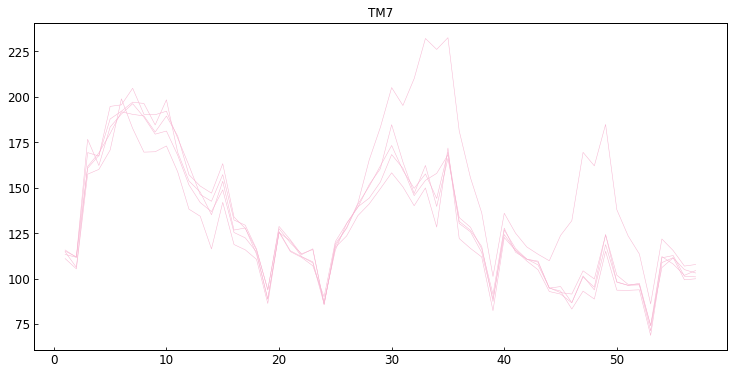

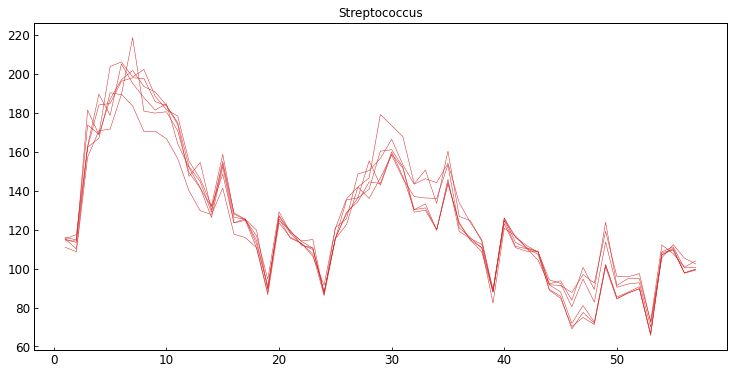

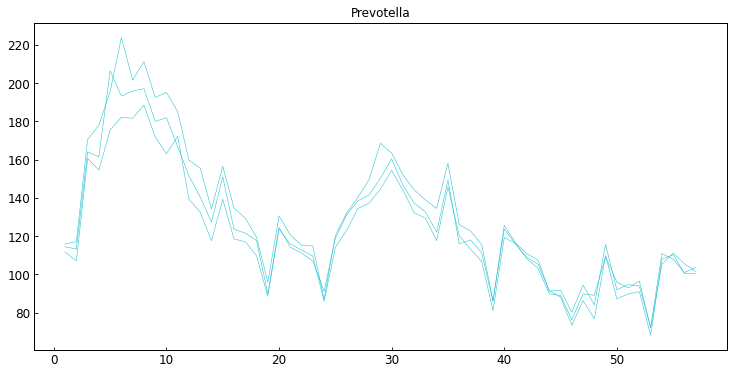

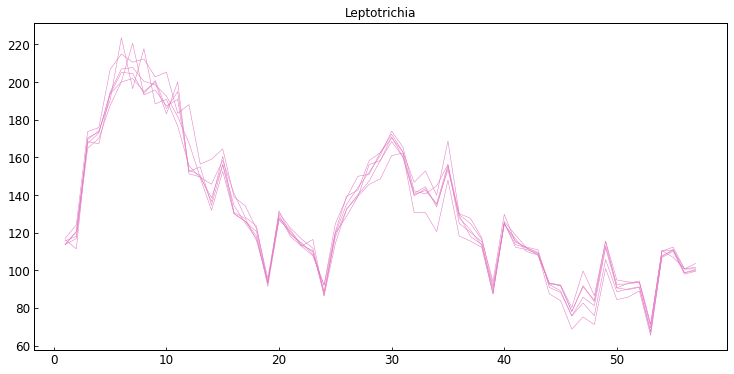

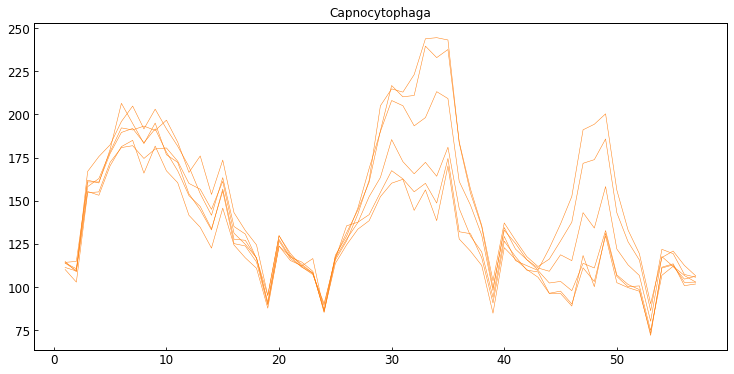

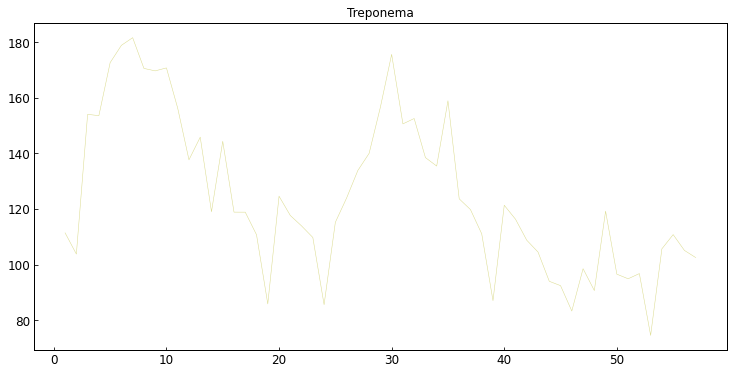

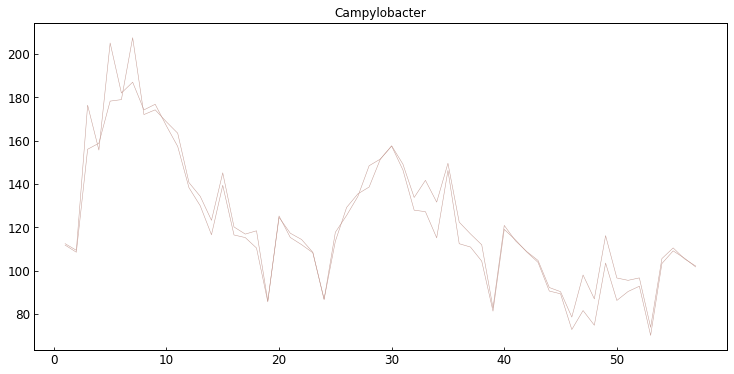

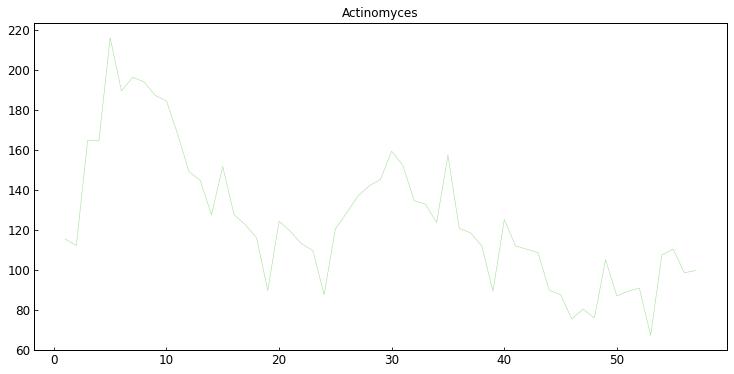

In [148]:
for scn, s in dict_sciname_spec.items():
    color = dict_sciname_col[scn]
    fig, ax = ip.general_plot(dims=spec_dims)
    spec_ = np.vstack(s)
    fsi.plot_cell_spectra(ax, spec_, {'lw':0.5,'alpha':1,'color':color})
    ax.set_title(scn)

## Scratch paper automated id cluster

In [ ]:
m = 5

In [ ]:
# if not os.path.exists(out_bn + '.png'):
print('----------Tile:', m,'--------------')
stack = np.load(stack_fn.format(m=m))    
props = pd.read_csv(props_fn.format(m=m))    
seg = np.load(seg_fn.format(m=m))  


with open(spec_fn.format(m=m), 'r') as f:
    dict_lab_spec = yaml.unsafe_load(f)
    # spec = yaml.load(f, Loader=Loader)
with open(clust_fn.format(m=m), 'r') as f:
    dict_lab_clust = yaml.unsafe_load(f)

----------Tile: 5 --------------


In [ ]:
classif_dir = output_dir + '/classif_plots'
if not os.path.exists(classif_dir): 
    os.makedirs(classif_dir)
    print("made dir", classif_dir)

bn = sn + '_M_{m}'

classif_bn = classif_dir + '/' + bn + '_classif'
out_bn = classif_bn.format(m=m)


made dir ../../outputs/agglomerative_cluster/2023_10_18_hsdm_slide_IVB_fov_01/classif_plots


In [ ]:
dict_cl_spec = defaultdict(list)
for l, cl in dict_lab_clust.items():
    dict_cl_spec[cl].append(dict_lab_spec[l])

In [ ]:
dict_cl_specmean = {cl: np.mean(s, axis=0) for cl, s in dict_cl_spec.items()}
dict_cl_specnorm = {cl: s / np.sum(s) for cl, s in dict_cl_specmean.items()}

In [ ]:
n_clust = len(dict_cl_specnorm)
n_chan = dict_cl_specnorm[cl].shape[0]
diff_mat = np.zeros((n_clust,n_clust,n_chan))
for i, s_i in enumerate(dict_cl_specnorm.values()):
    for j, s_j in enumerate(dict_cl_specnorm.values()):
        diff_mat[i,j,:] = s_i - s_j

In [ ]:
n_ref = len(weights_sum_norm)
ref_dist_mat = np.zeros((n_ref, n_ref, n_chan))
for i, s_i in enumerate(weights_sum_norm):
    for j, s_j in enumerate(weights_sum_norm):
        ref_dist_mat[i,j,:] = s_i - s_j


In [ ]:
cl_ref_mat = np.zeros((n_clust,n_clust,2))
for i in range(n_clust):
    for j in range(n_clust):
        # if j > i:
        s_diff = diff_mat[i,j,:]
        dist = 1e10
        k_l = [n_ref,n_ref]
        for k in range(n_ref):
            for l in range(n_ref):
                ref_diff = ref_dist_mat[k,l,:]
                dist_ = fhc.channel_cosine_intensity_allonev2(s_diff, ref_diff)
                if dist_ < dist:
                    dist = dist_
                    k_l[:] = [k,l]
        cl_ref_mat[i,j,:] = k_l
        


In [ ]:
np.unique([1,2,2,2,2,2,3,3,3,3], return_counts=True)

(array([1, 2, 3]), array([1, 5, 4]))

In [ ]:
ref_i[5]

16.0

In [ ]:
dict_cl_sciname = {}
for i, cl in enumerate(dict_cl_specnorm.keys()):
    cl_ref = cl_ref_mat[i,:,0]
    ref_i, counts = np.unique(cl_ref, return_counts=True)
    mx_i = np.argwhere(counts == np.max(counts))[0][0]
    dict_cl_sciname[cl] = sci_names[int(ref_i[mx_i])]

In [ ]:
dict_sciname_count = defaultdict(lambda:0)
for cl, sciname in dict_cl_sciname.items():
    count_ = len(dict_cl_spec[cl])
    dict_sciname_count[sciname] += count_
dict_sciname_count

defaultdict(<function __main__.<lambda>()>,
            {'Neisseriaceae': 1499,
             'Veillonella': 2910,
             'Capnocytophaga': 400,
             'Corynebacterium': 1474,
             'Streptococcus': 563,
             'Leptotrichia': 606,
             'Fusobacterium': 227})

In [ ]:
scn_count = list(dict_sciname_count.values())
scinames = list(dict_sciname_count.keys())
scinames_sort = [x for _, x in sorted(zip(scn_count, scinames))][::-1]
scinames_sort

['Veillonella',
 'Neisseriaceae',
 'Corynebacterium',
 'Leptotrichia',
 'Streptococcus',
 'Capnocytophaga',
 'Fusobacterium']

In [ ]:
colors = plt.get_cmap('tab10').colors
dict_sciname_col = dict(zip(scinames_sort, colors))

In [ ]:
resolution = 0.05990374007588672

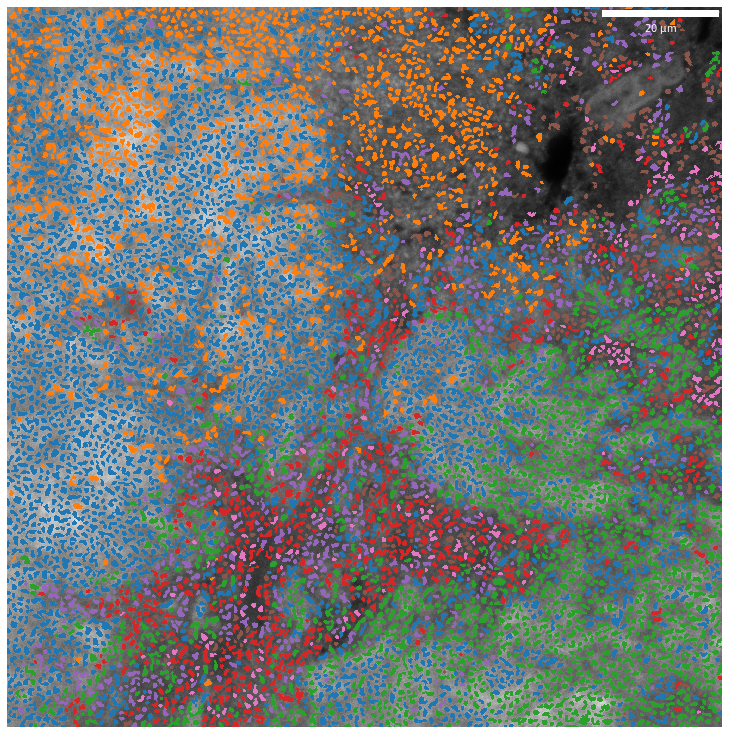

In [ ]:


im_sum = np.sum(stack, axis=2)
mx = np.max(im_sum)
mn = np.min(im_sum)
im_norm = (im_sum - mn) / (mx - mn)
im_rgb = im_norm[:,:,None] * np.array([1,1,1])[None,:]
fig, ax, cbar = ip.plot_image(im_rgb, im_inches=imin)
plt.show()
plt.close()


labels = list(dict_lab_clust.keys())
im_rgb = im_norm[:,:,None] * np.array([1,1,1])[None,:]
for i, row in props.iterrows():
    l = row.label
    if l in labels:
        b = row.bbox
        cl = dict_lab_clust[l]
        if cl:
            sciname = dict_cl_sciname[cl]
            if sciname:
                # dict_sciname_counts[sciname] += 1
                color = np.array(dict_sciname_col[sciname])
                b = eval(b) if isinstance(b, str) else b
                rgb_sub = im_rgb[b[0]:b[2],b[1]:b[3]]
                seg_sub = seg[b[0]:b[2],b[1]:b[3]] == l
                im_sub = im_norm[b[0]:b[2],b[1]:b[3]]
                rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*3)
                # rgb_cell = (im_sub * seg_sub)[:,:,None] * color[None,:]        
                rgb_cell = seg_sub[:,:,None] * color[None,:]
                im_rgb[b[0]:b[2],b[1]:b[3],:] = rgb_noncell + rgb_cell

fig, ax, cbar = ip.plot_image(im_rgb, im_inches=10, scalebar_resolution=resolution)
plt.show()
plt.close()
    # ip.save_png_pdf(out_bn)

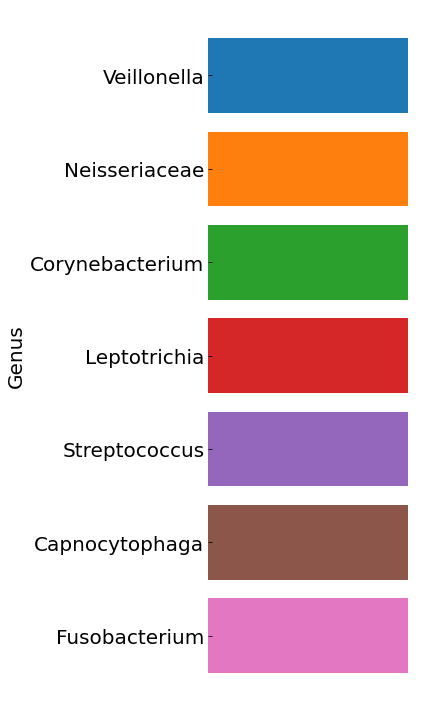

In [ ]:
# s_ = dict_sciname_counts.keys()
# c_ = dict_sciname_counts.values()
# cl_ = dict_sciname_col.values()

# scinames_countsort = [x for _, x in sorted(zip(c_, s_))][::-1]
colors_countsort = [dict_sciname_col[sciname] for sciname in scinames_sort]

ip.taxon_legend(scinames_sort, colors_countsort)
# ip.save_png_pdf(classif_dir + '/' + sn + '_taxon_legend')

In [ ]:
dict_sciname_spec = defaultdict(list)
for cl, s in dict_cl_spec.items():
    scn = dict_cl_sciname[cl]
    dict_sciname_spec[scn] += s

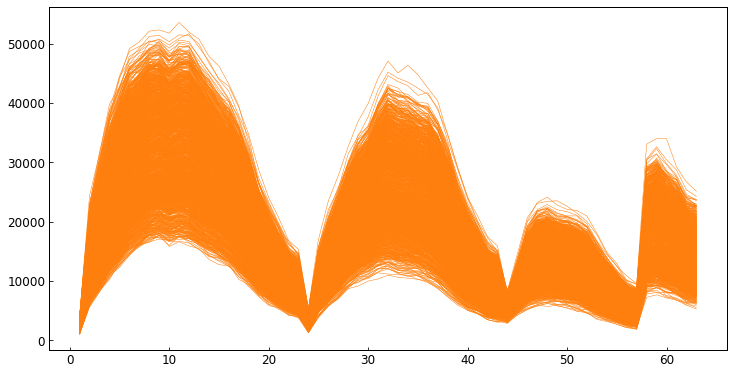

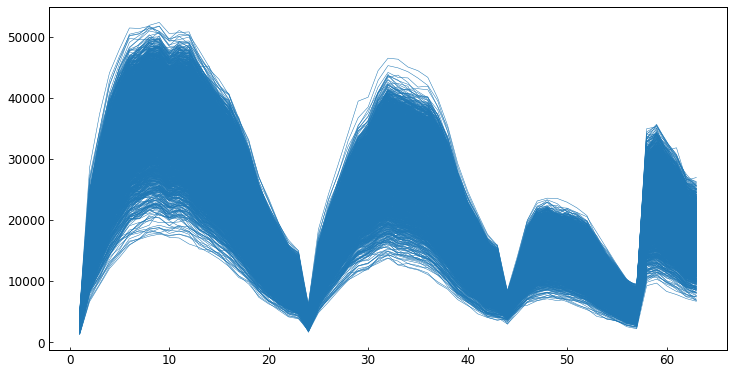

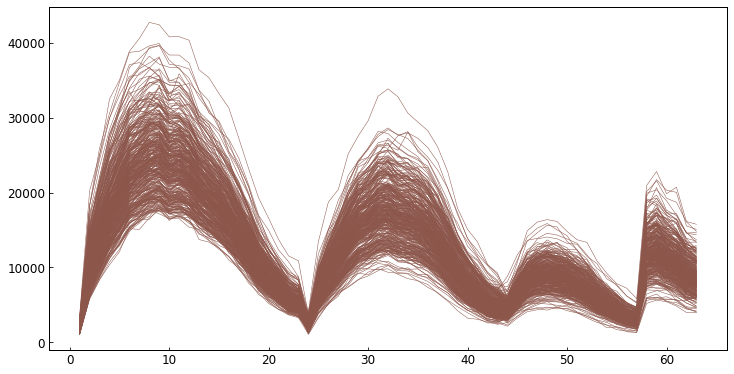

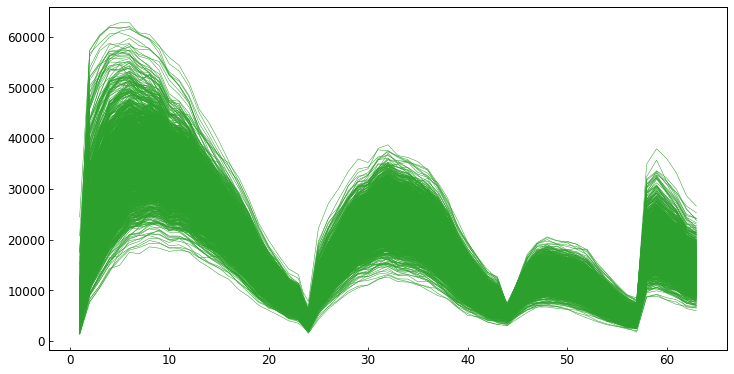

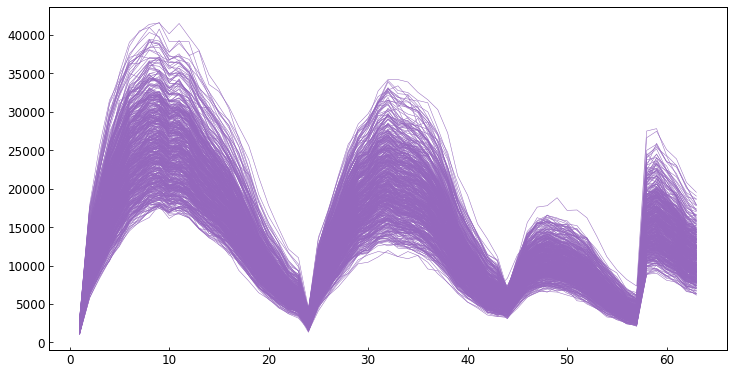

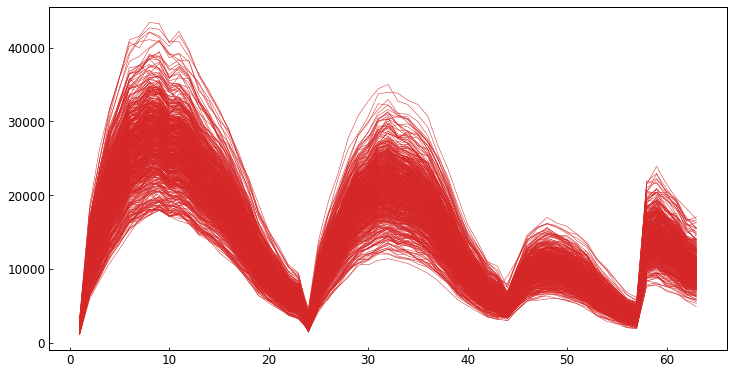

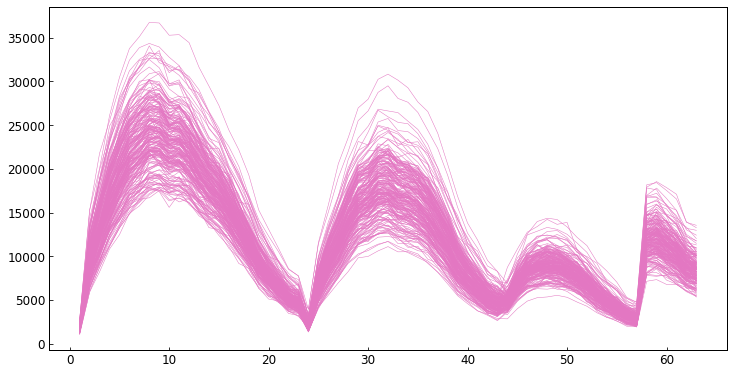

In [ ]:
for scn, s in dict_sciname_spec.items():
    color = dict_sciname_col[scn]
    fig, ax = ip.general_plot(dims=spec_dims)
    spec_ = np.vstack(s)
    fsi.plot_cell_spectra(ax, spec_, {'lw':0.5,'alpha':1,'color':color})

## Manually ID clusters

In [117]:
dict_m_clust_sciname = {
    0:{
        6:'Actinomyces',
        1:'Streptococcus'
    },
    1:{
        36:'Actinomyces',
        2:'',
        6:'Streptococcus'
    },
    2:{
        3:'Rothia',
        6:'Fusobacterium',
        8:'Actinomyces',
        10:'Porphyromonas',
        9:'Porphyromonas',
        5:'Actinomyces',
        57:'Actinomyces'
    },
    3:{
        11:'Actinomyces',
        10:'Actinomyces',
        8:'Streptococcus',
        4:'Prevotella',
        5:'Rothia'
    },
    4:{
        5:'Actinomyces',
        6:'Actinomyces',
        1:'',
        4:'Rothia',
        3:'Streptococcus'
    },
    5:{
        30:'Actinomyces',
        7:'Actinomyces',
        5:'Actinomyces',
        1:'Streptococcus',
        10:'Streptococcus',
        12:'Streptococcus',
        4:'Neisseriaceae',
        8:'Rothia'

    },
    6:{
        4:'Actinomyces',
        8:'Actinomyces',
        5:'',
        2:'Prevotella',
        3:'Streptococcus',
        1:'Campylobacter'
    },
    7:{
        3:'Actinomyces',
        6:'Fusobacterium',
        7:'',
        45:'',
        5:'Rothia',
        1:'Streptococcus',
        4:''
    },
    8:{
        13:'Actinomyces',
        11:'Fusobacterium',
        10:'Pasteurellaceae',
        14:'Streptococcus',
        9:'Streptococcus',
        8:'Pasteurellaceae',
        1:'Pasteurellaceae'
    }
}

## Plot clusters and tiles for given image

----------Tile: 0 --------------
6


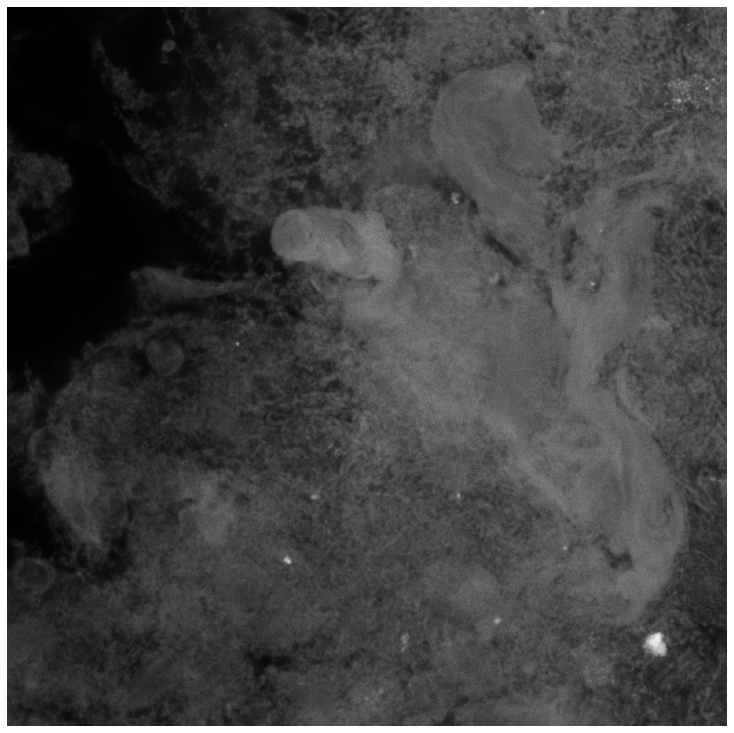

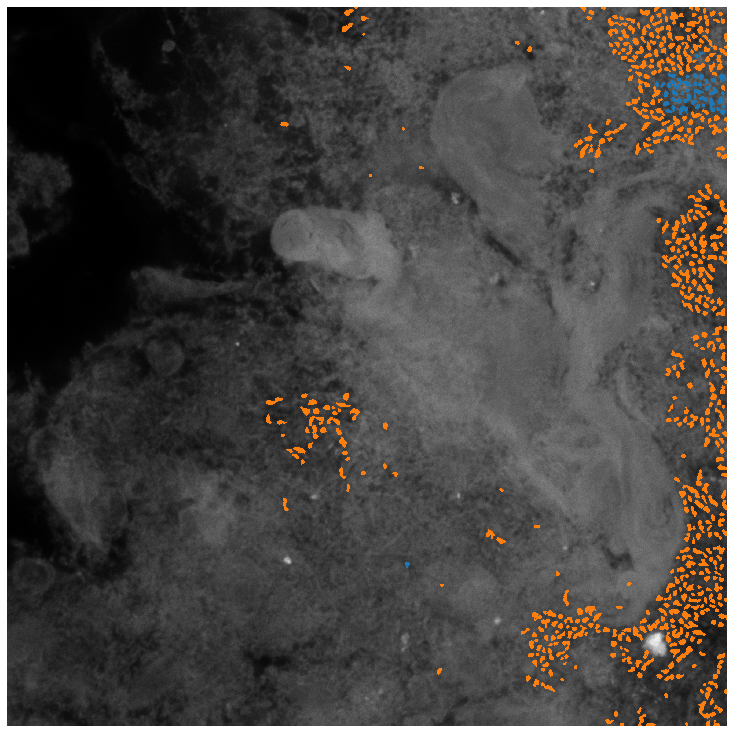

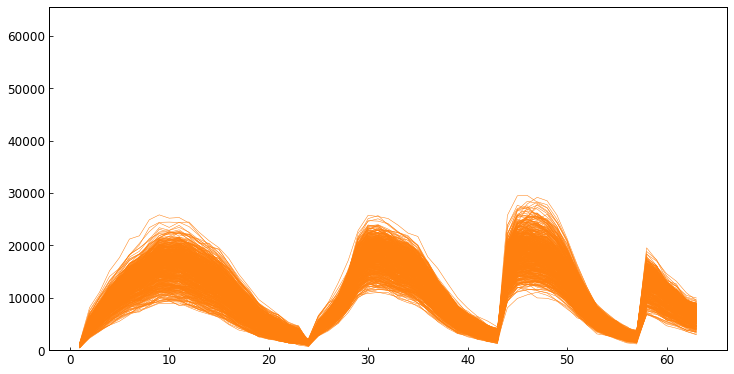

1


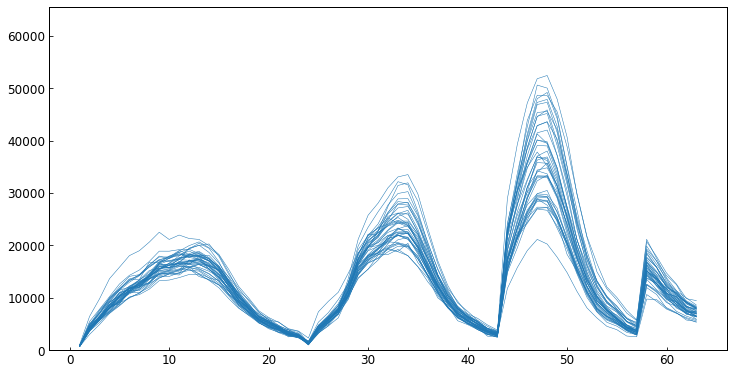

-------------------------------------
----------Tile: 1 --------------
36


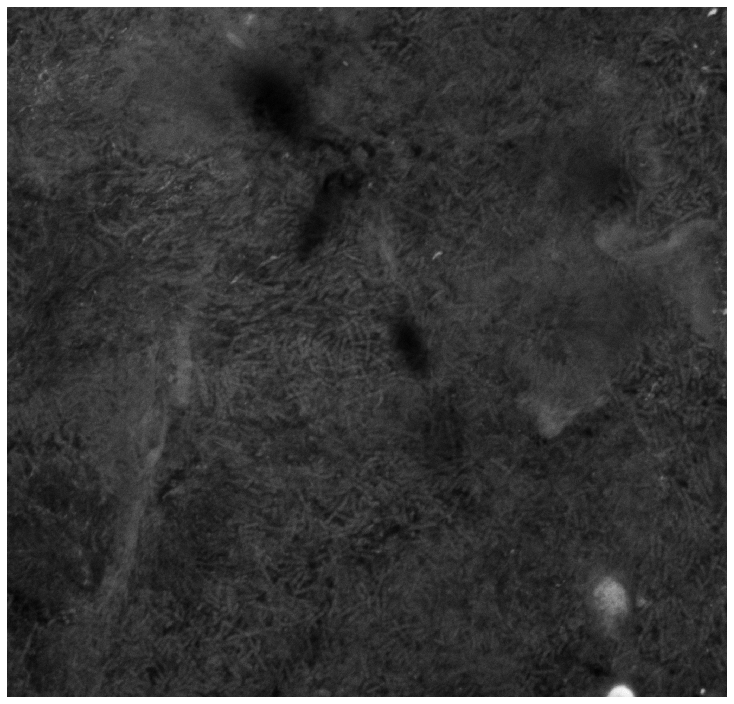

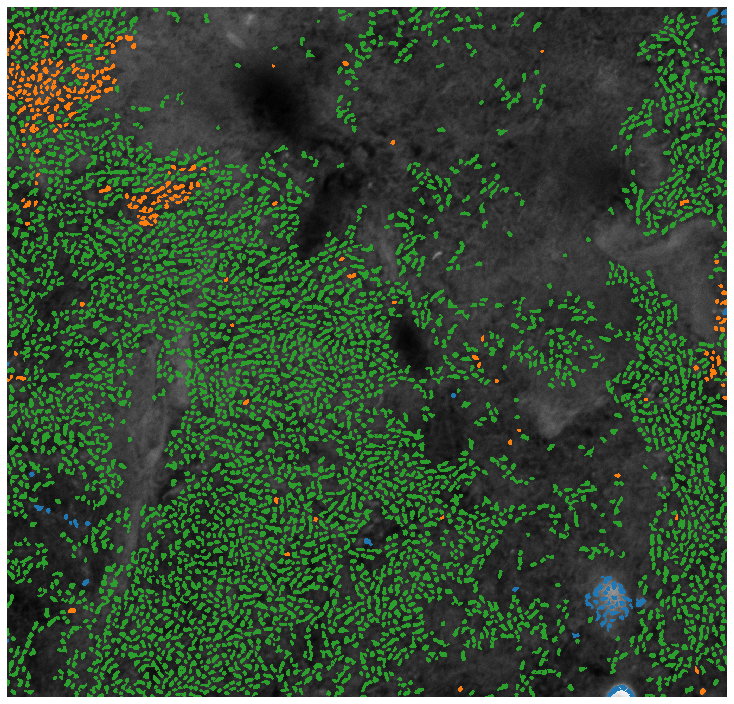

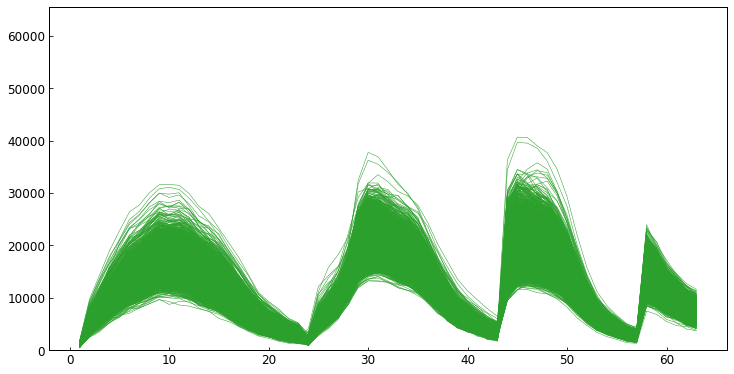

2


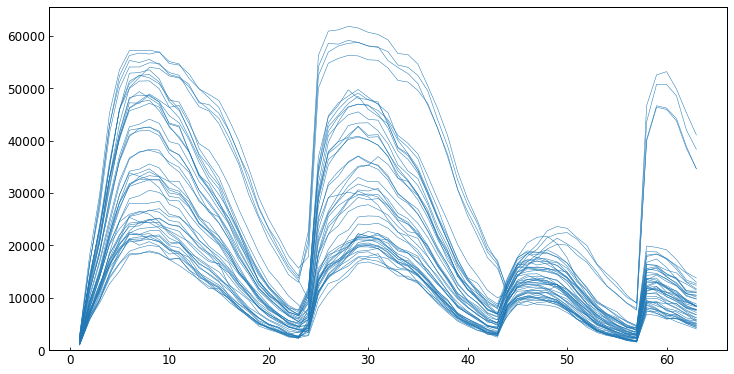

6


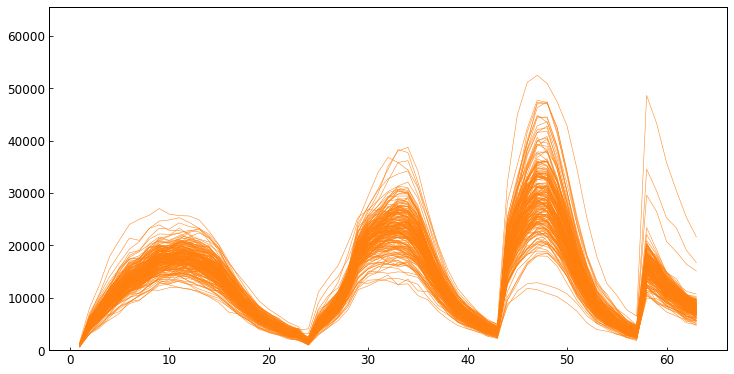

-------------------------------------
----------Tile: 2 --------------
3


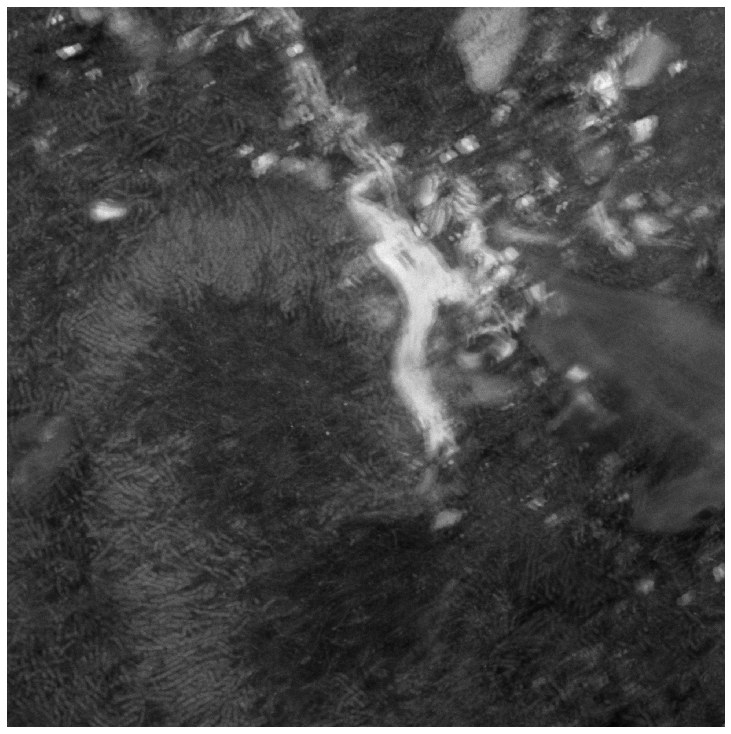

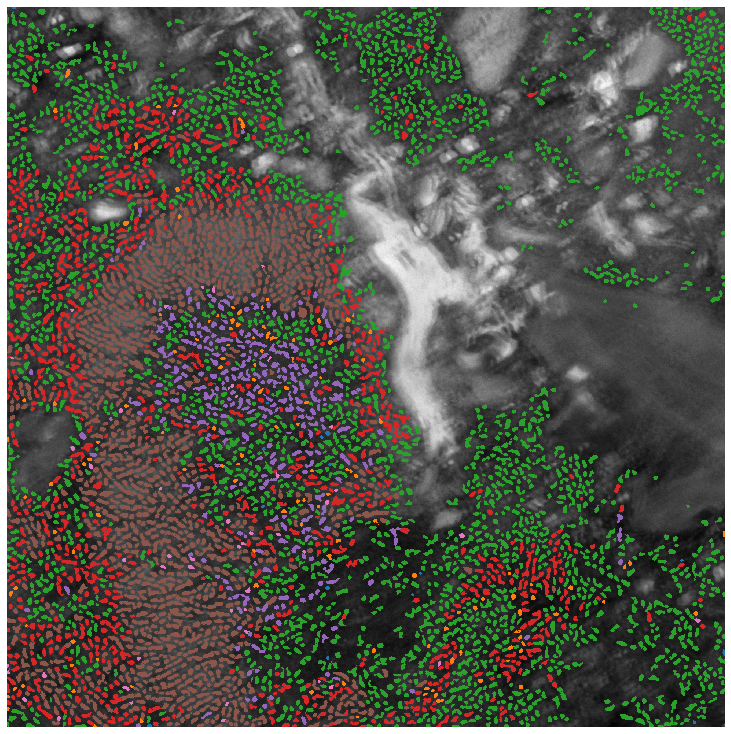

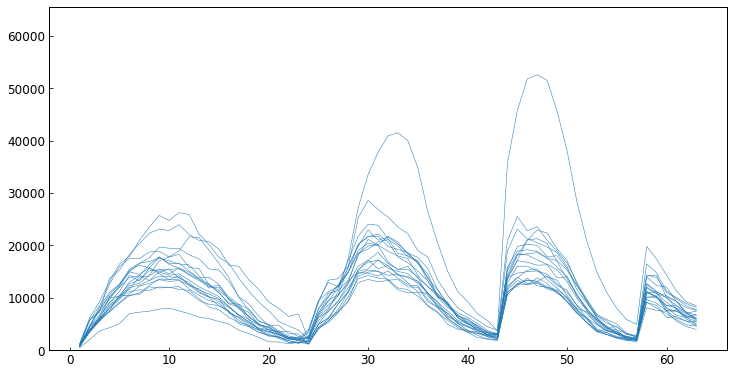

6


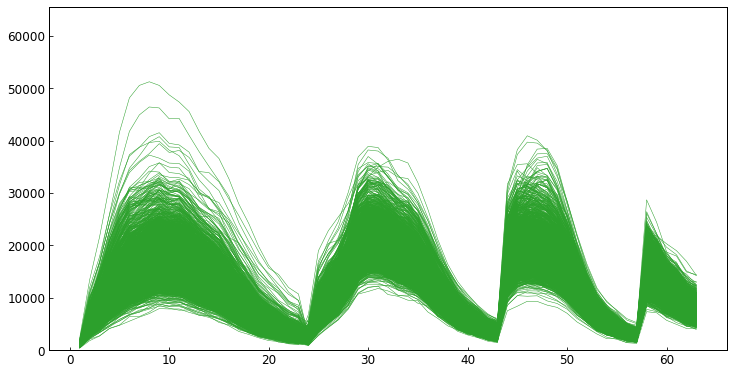

8


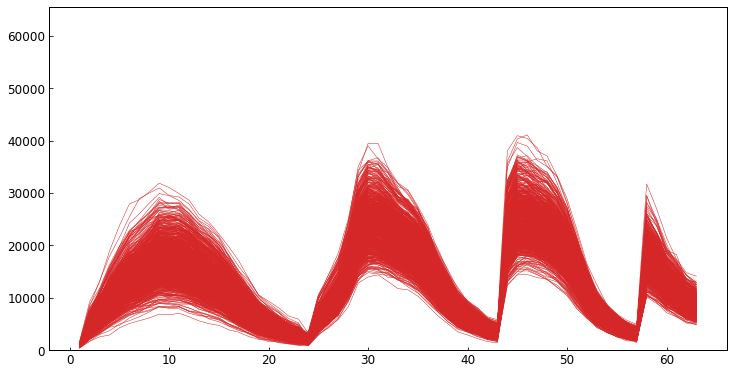

5


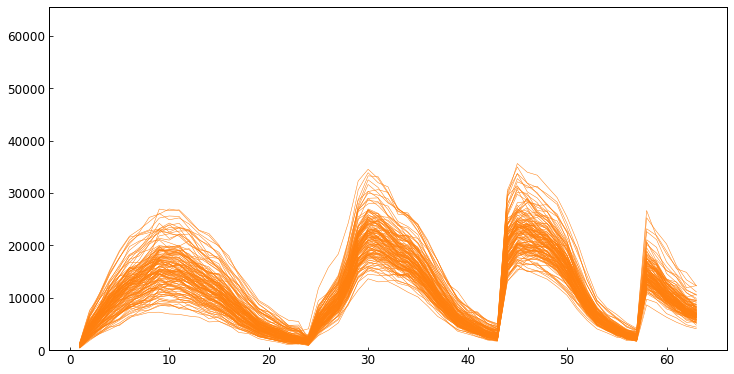

57


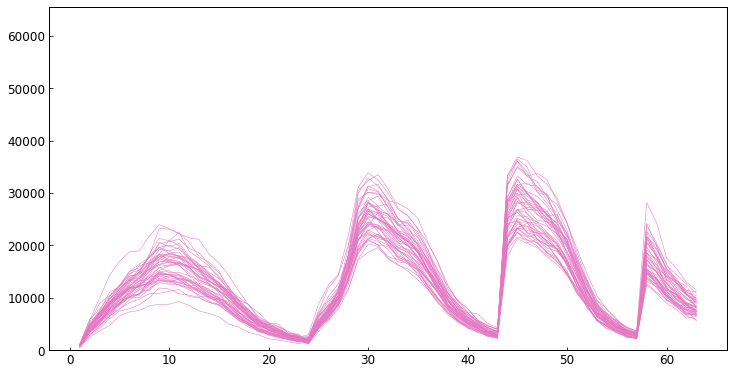

10


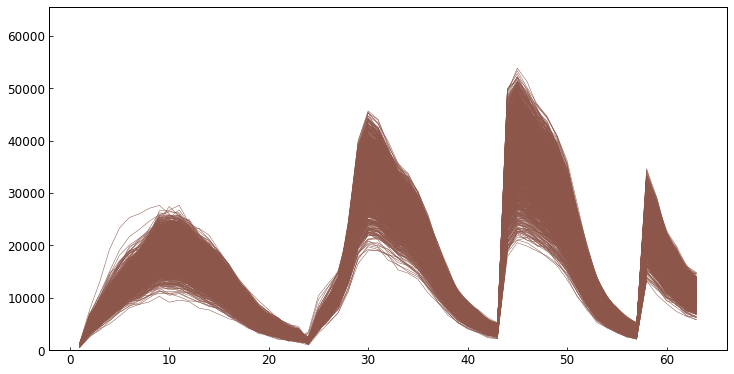

9


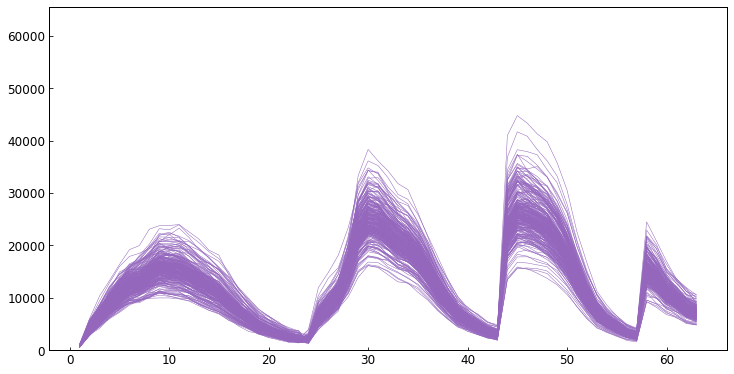

-------------------------------------
----------Tile: 3 --------------
11


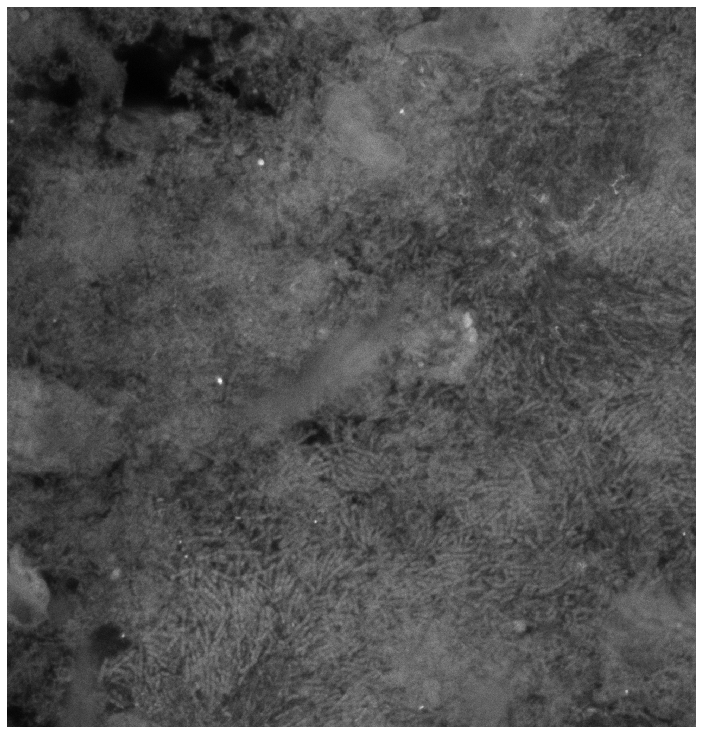

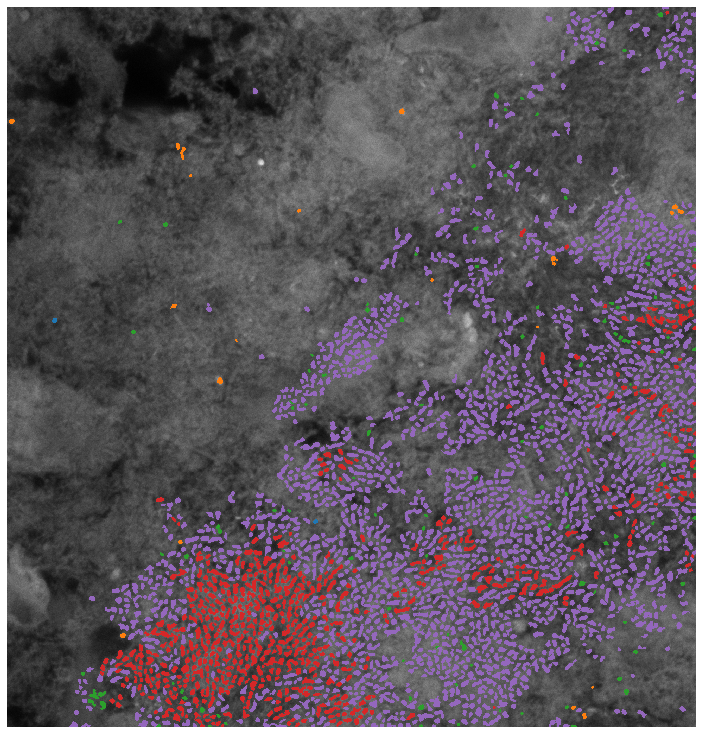

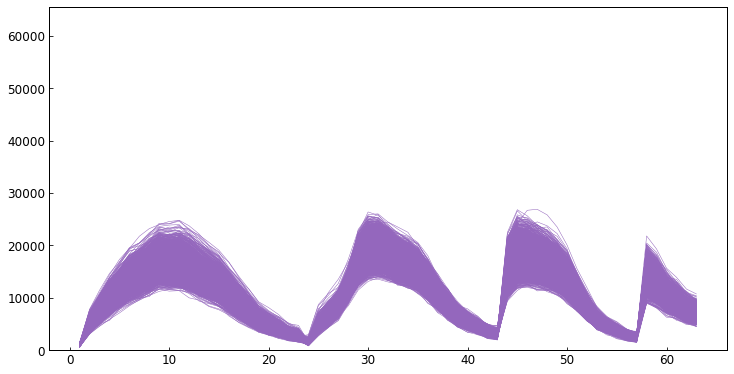

10


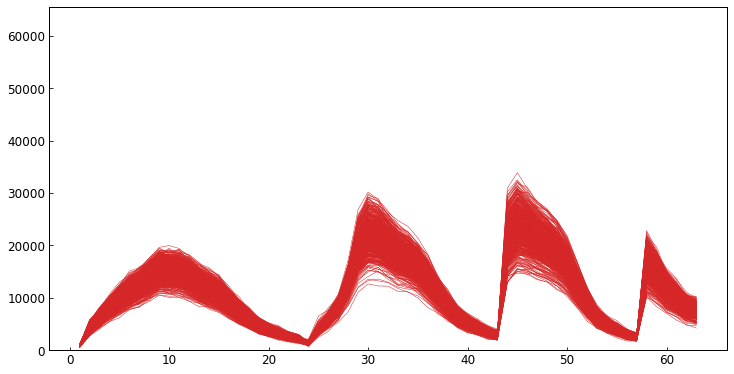

8


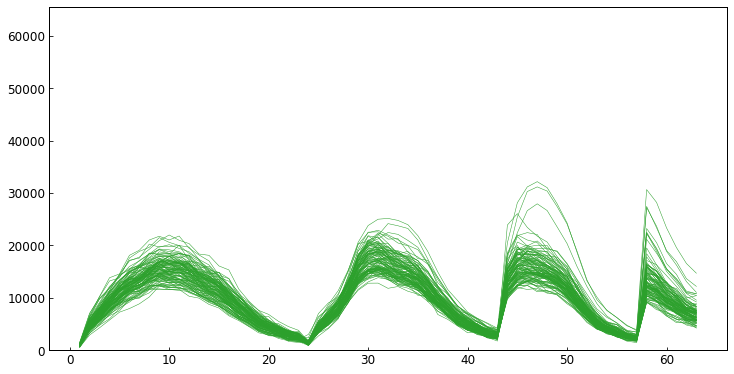

5


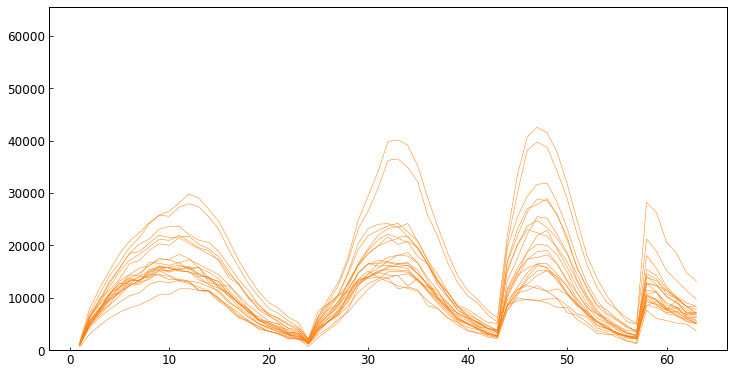

4


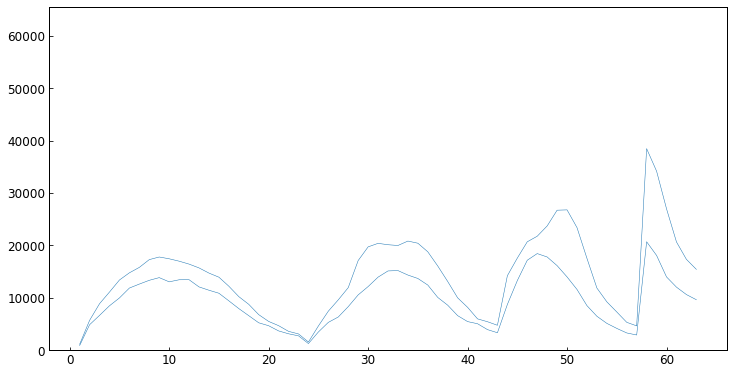

-------------------------------------
----------Tile: 4 --------------
1


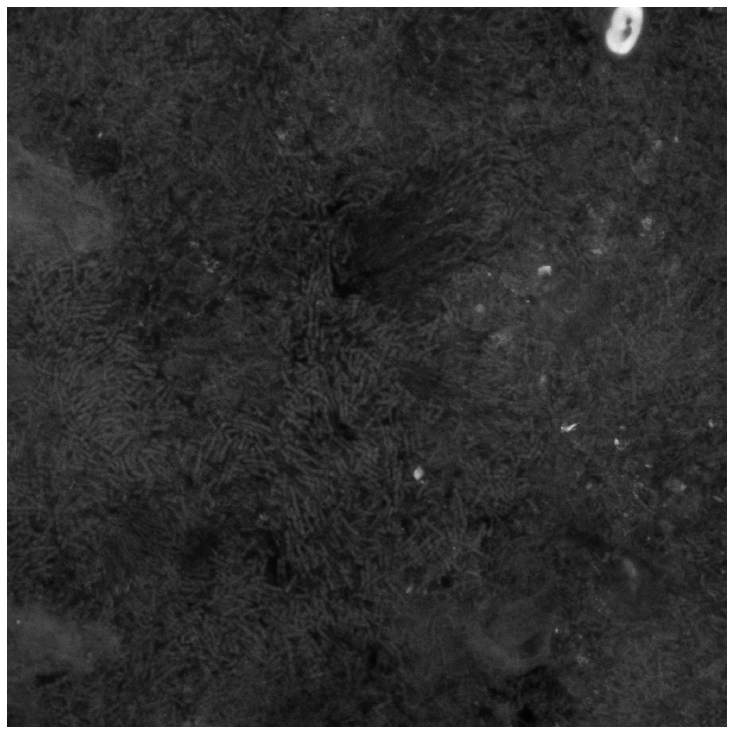

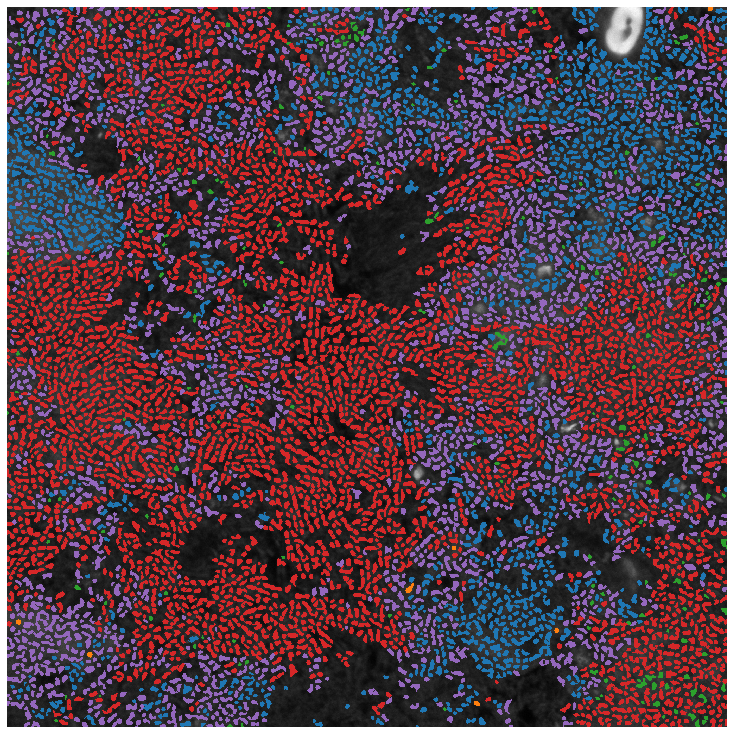

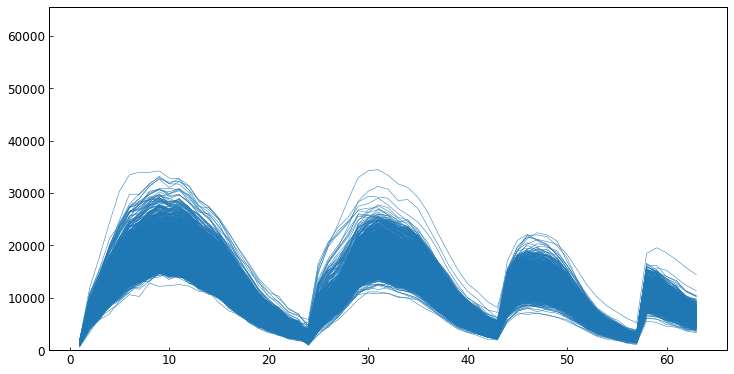

6


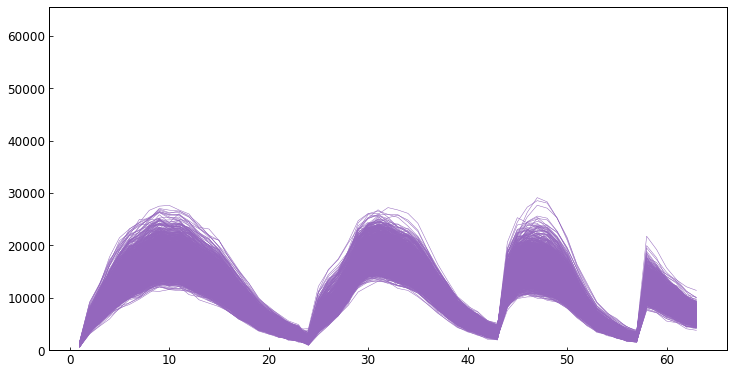

5


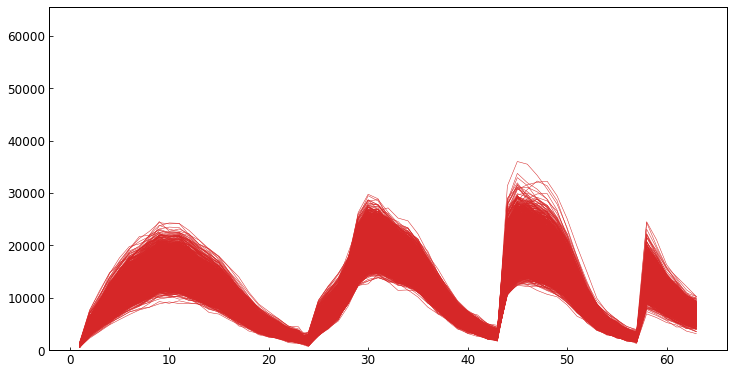

4


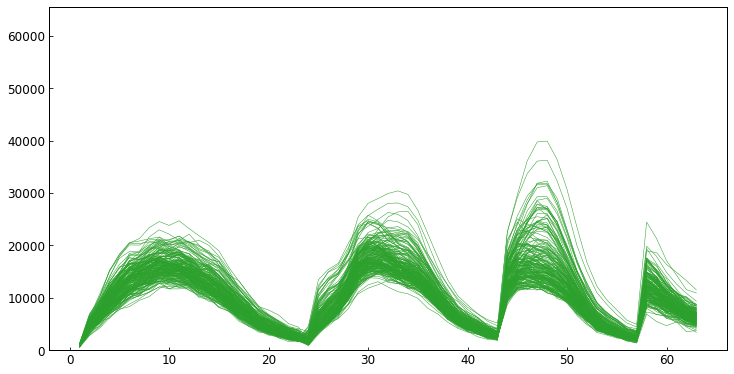

3


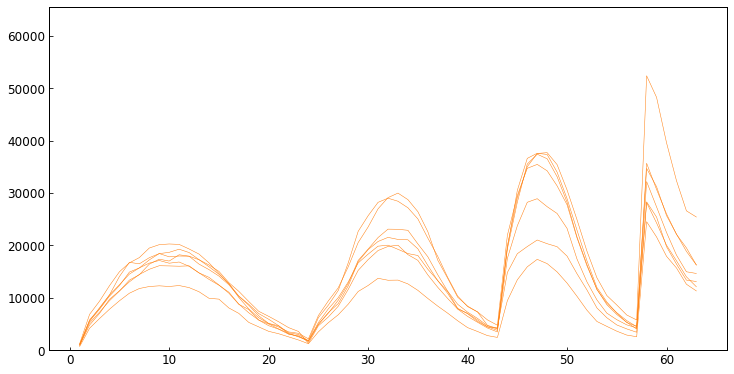

-------------------------------------
----------Tile: 5 --------------
5


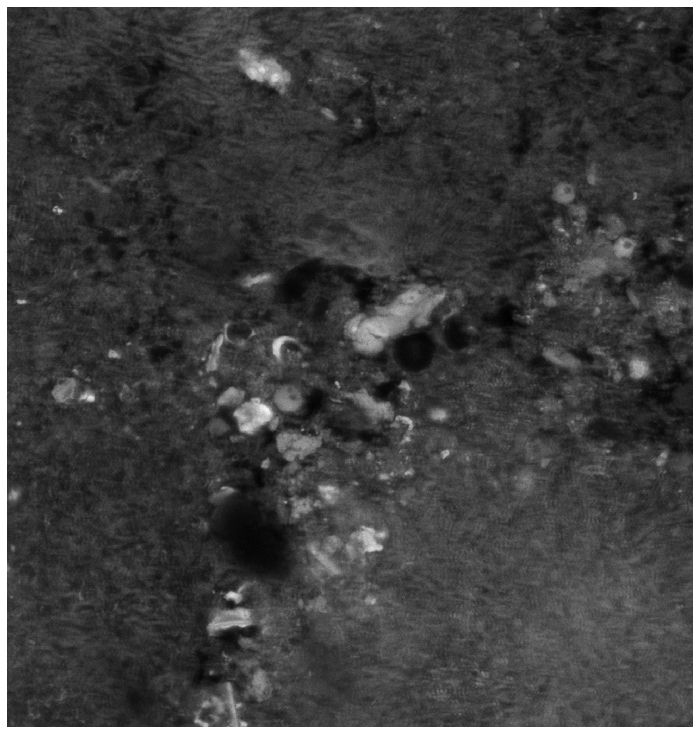

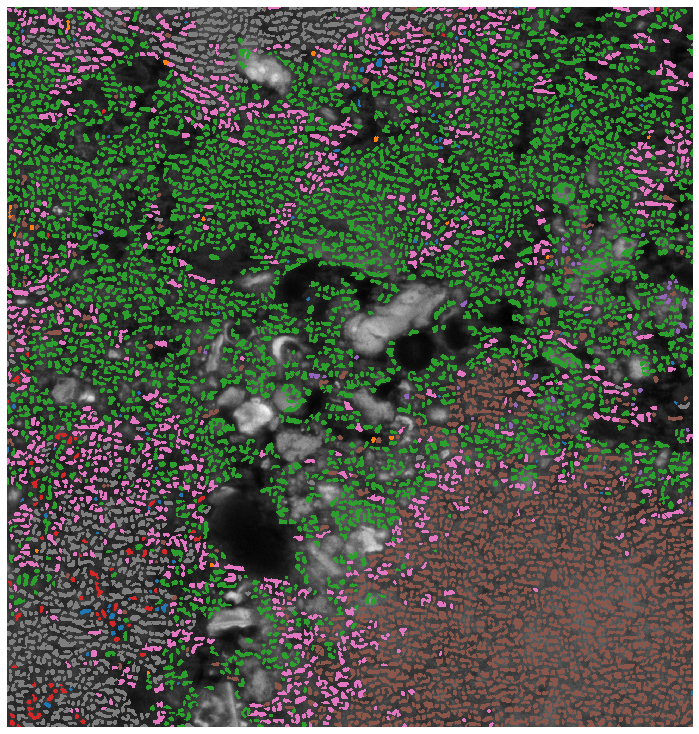

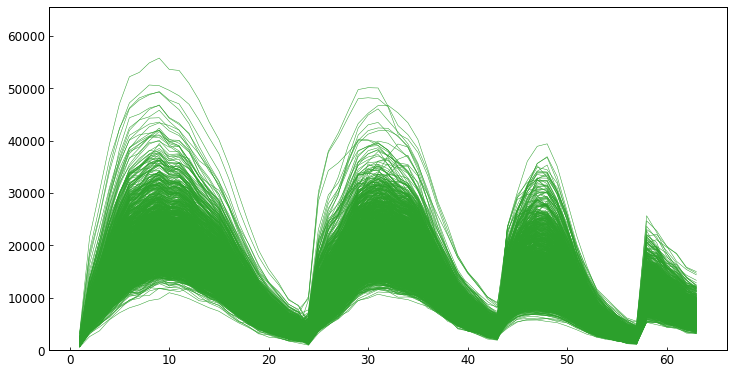

30


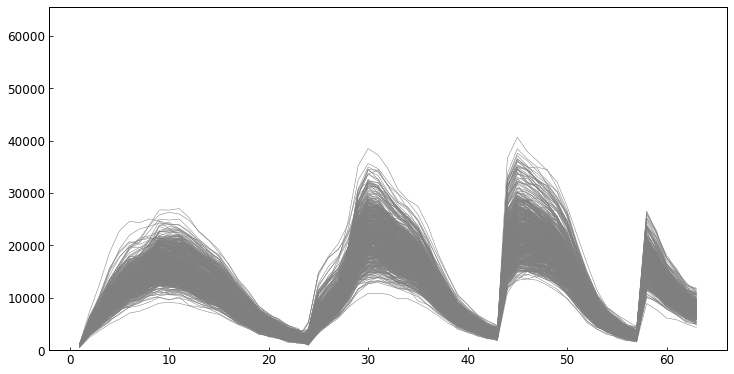

12


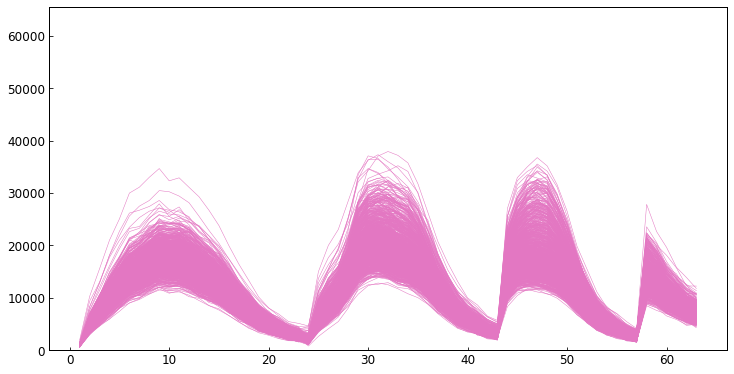

10


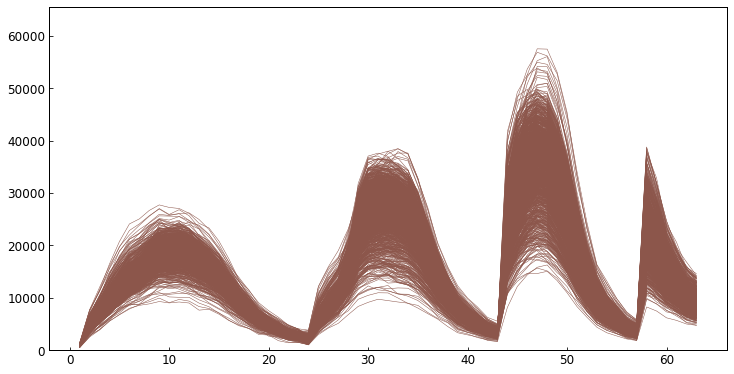

1


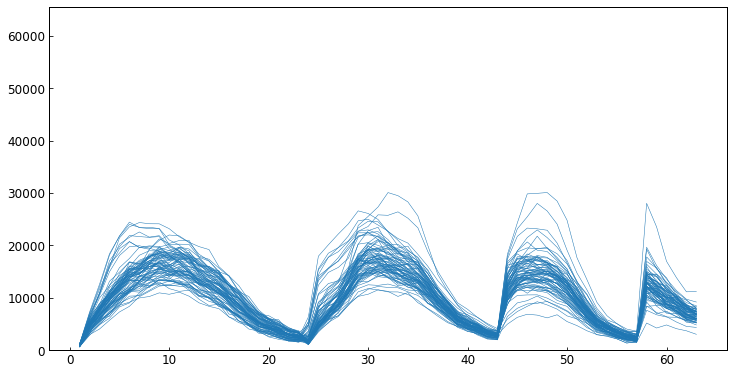

7


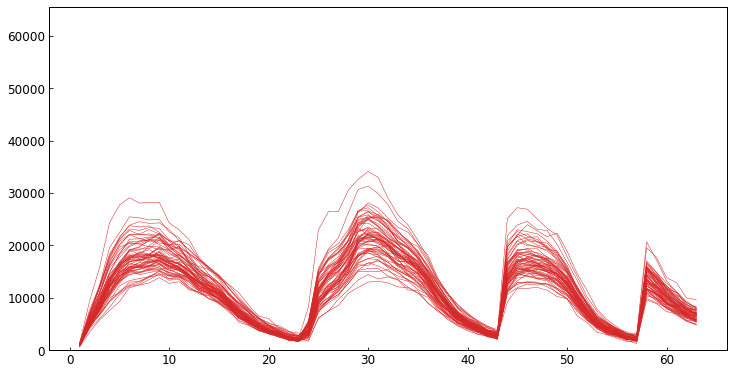

4


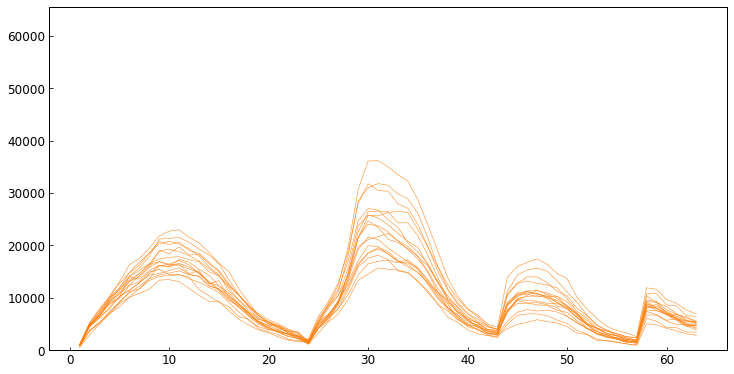

8


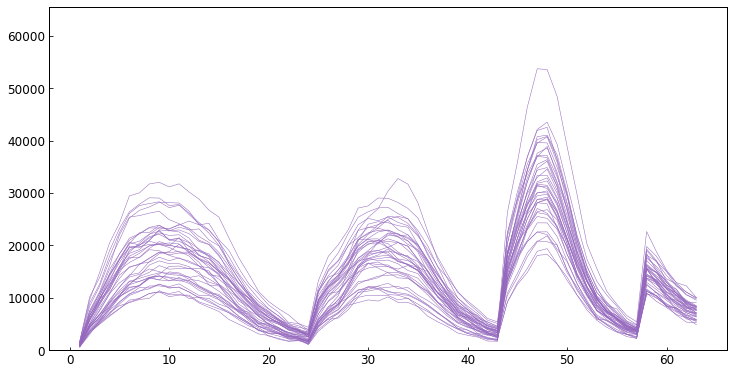

-------------------------------------
----------Tile: 6 --------------
8


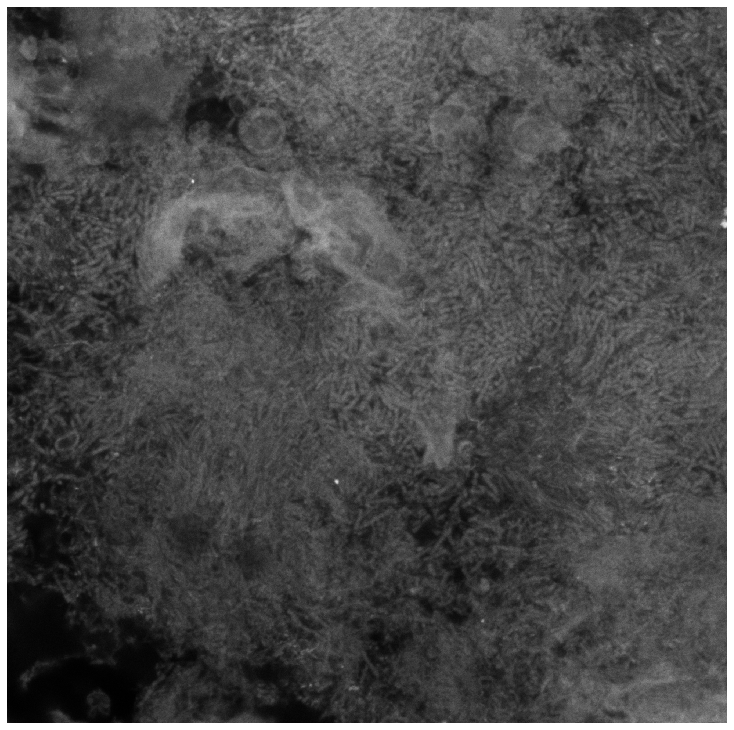

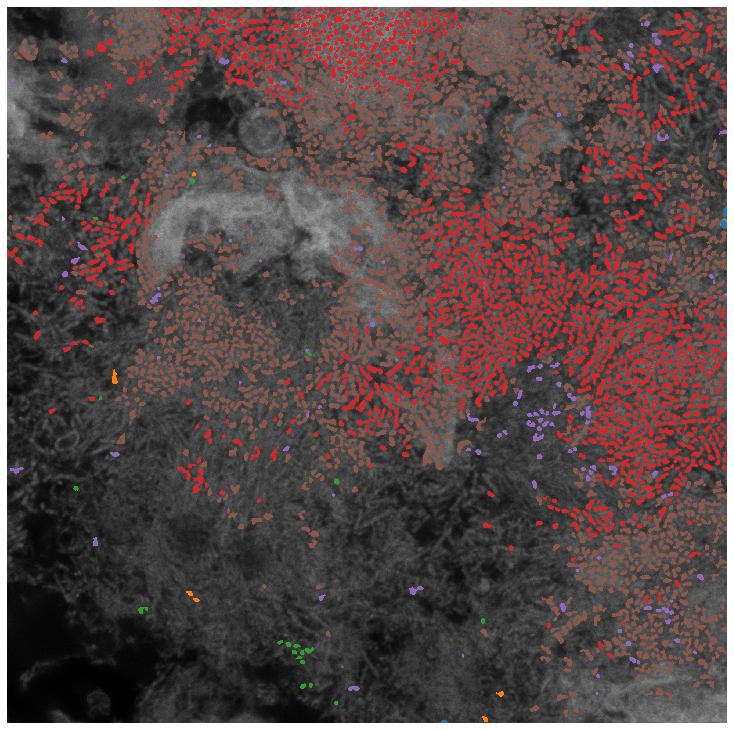

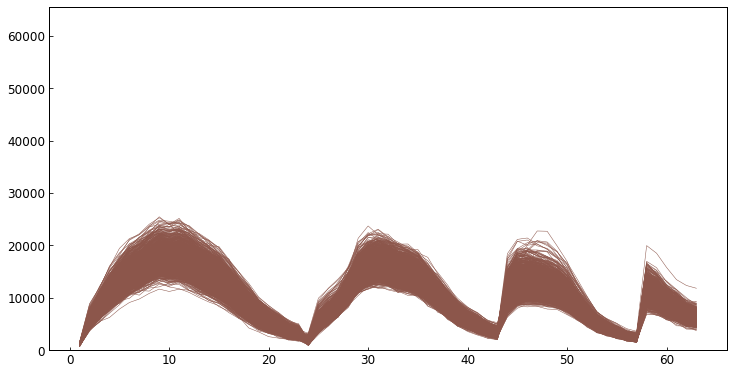

4


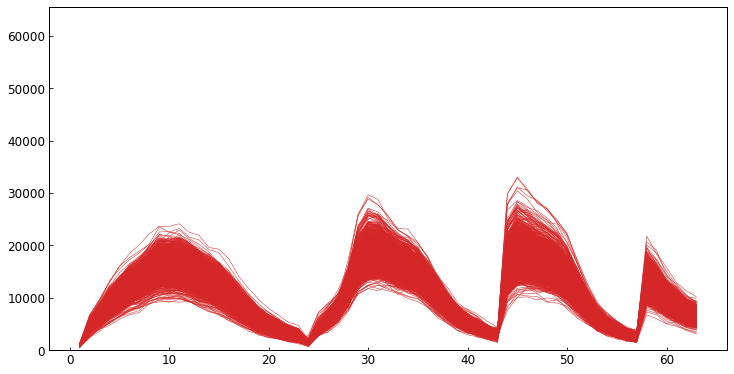

5


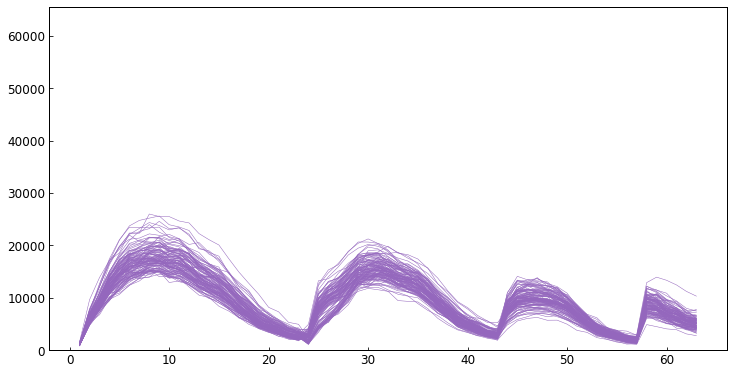

2


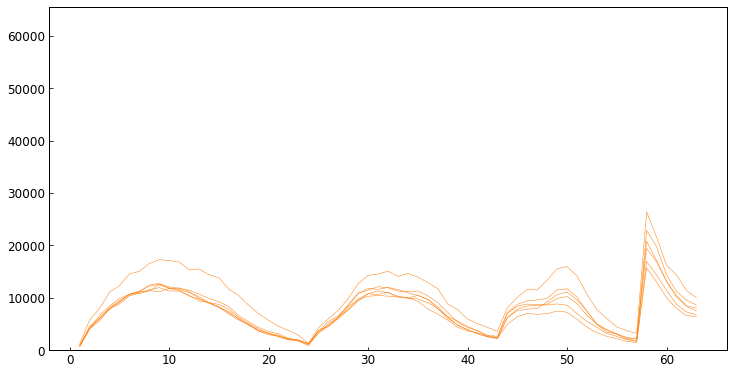

3


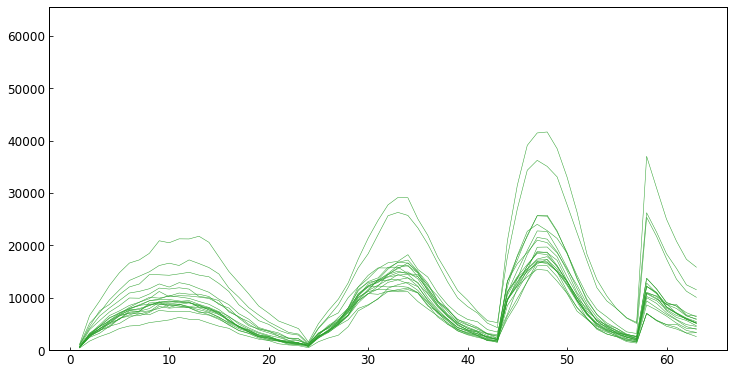

1


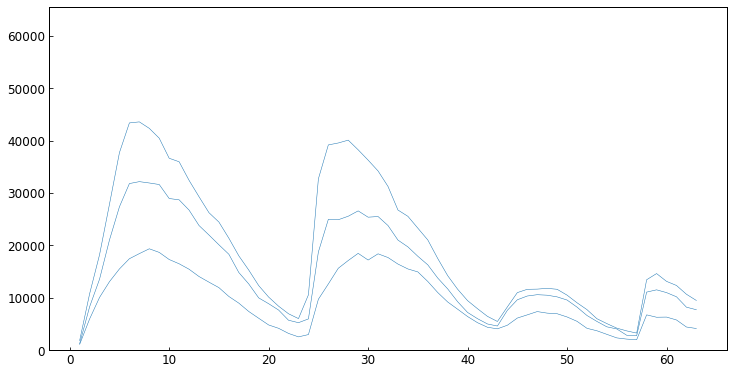

-------------------------------------
----------Tile: 7 --------------
6


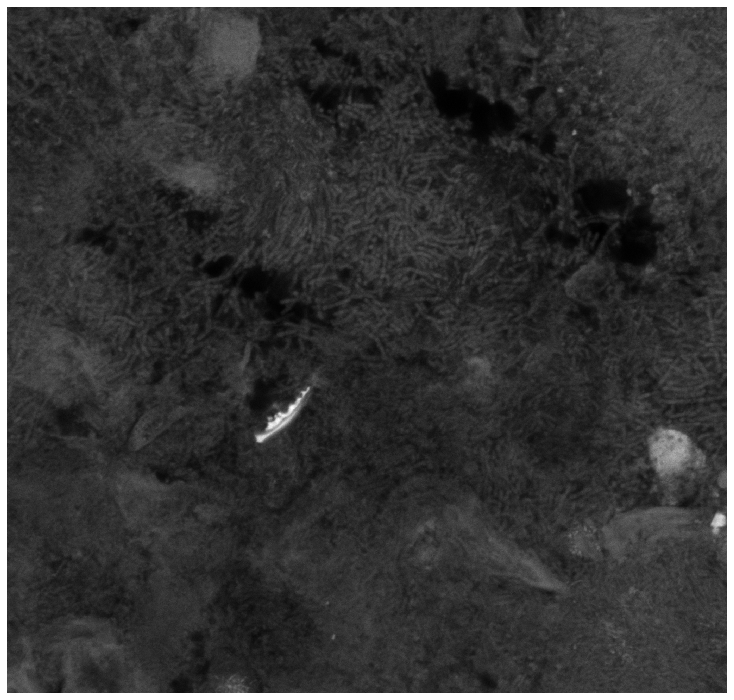

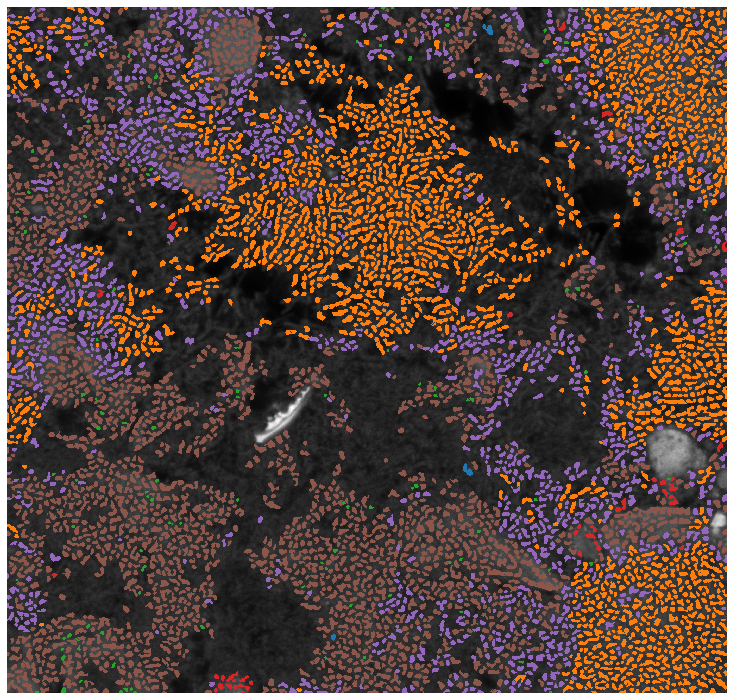

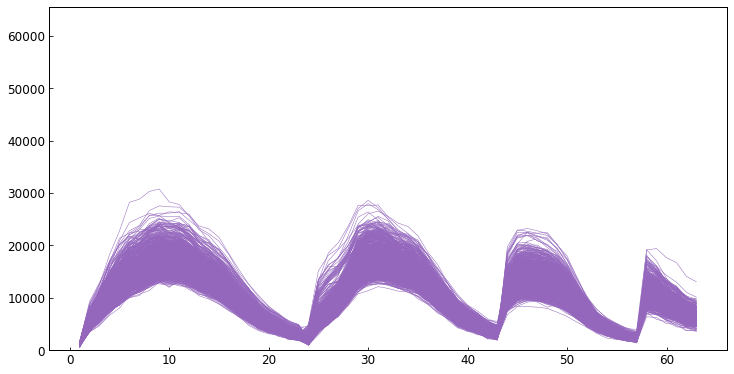

3


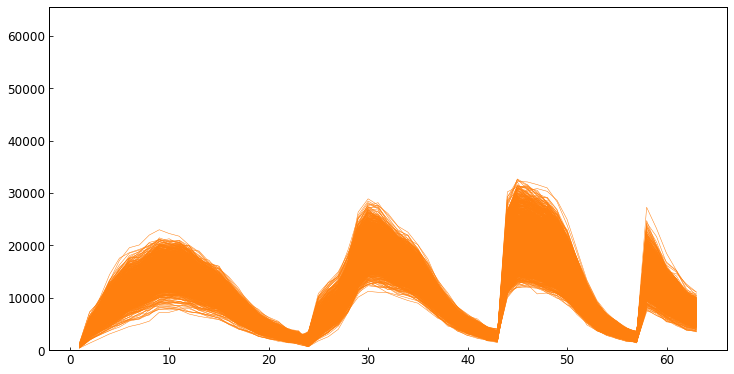

7


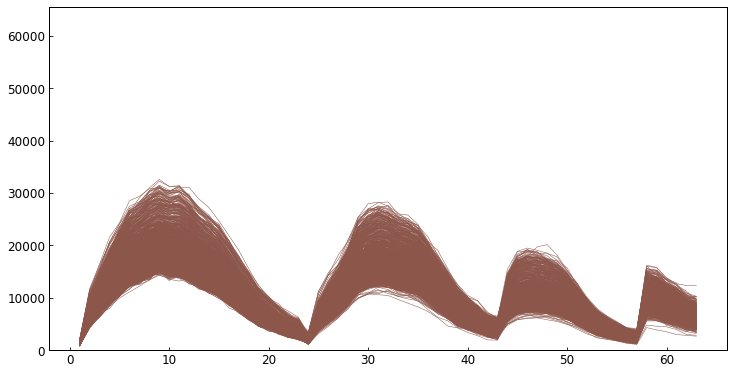

4


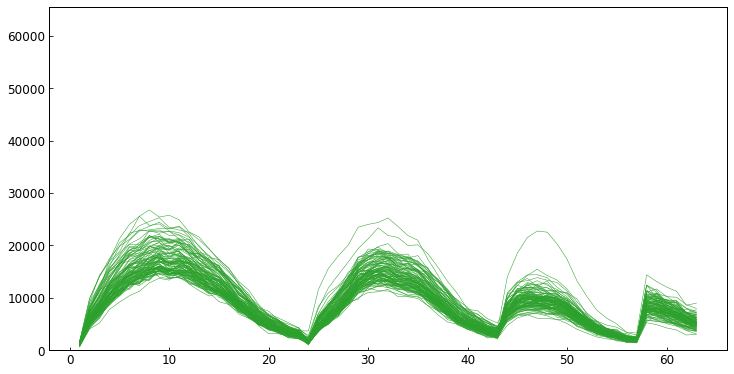

5


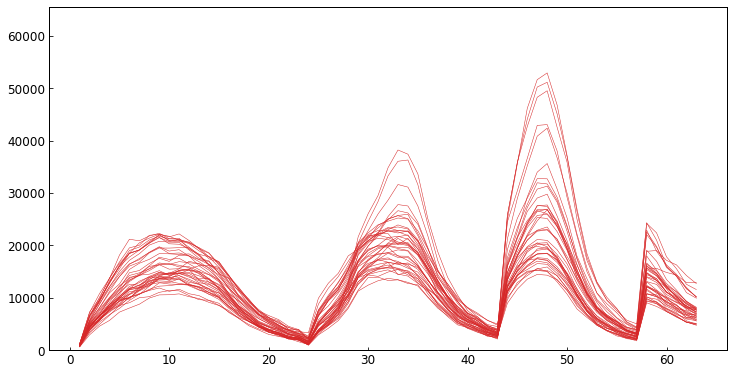

1


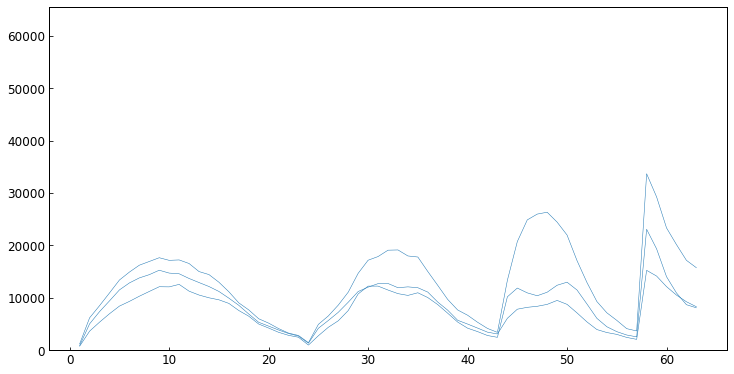

-------------------------------------
----------Tile: 8 --------------
11


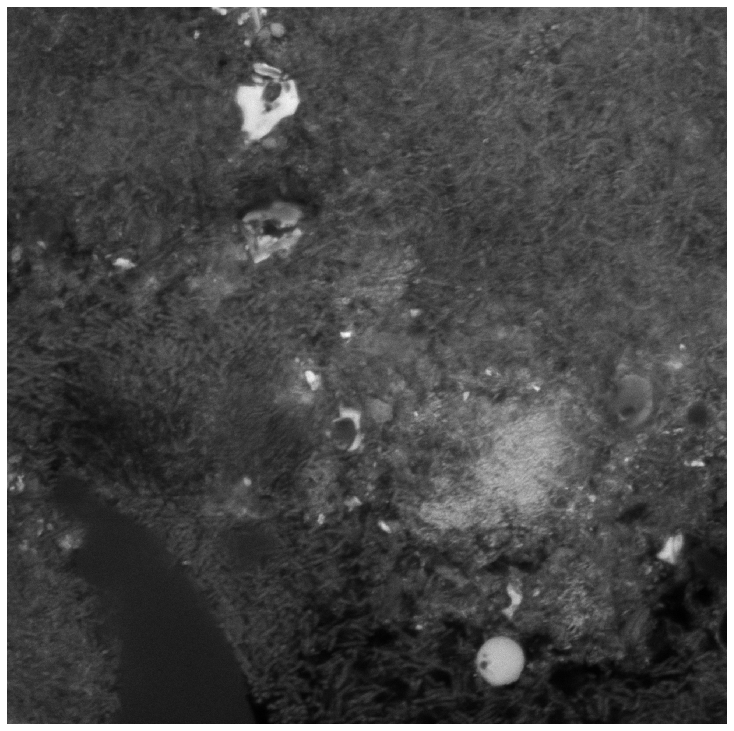

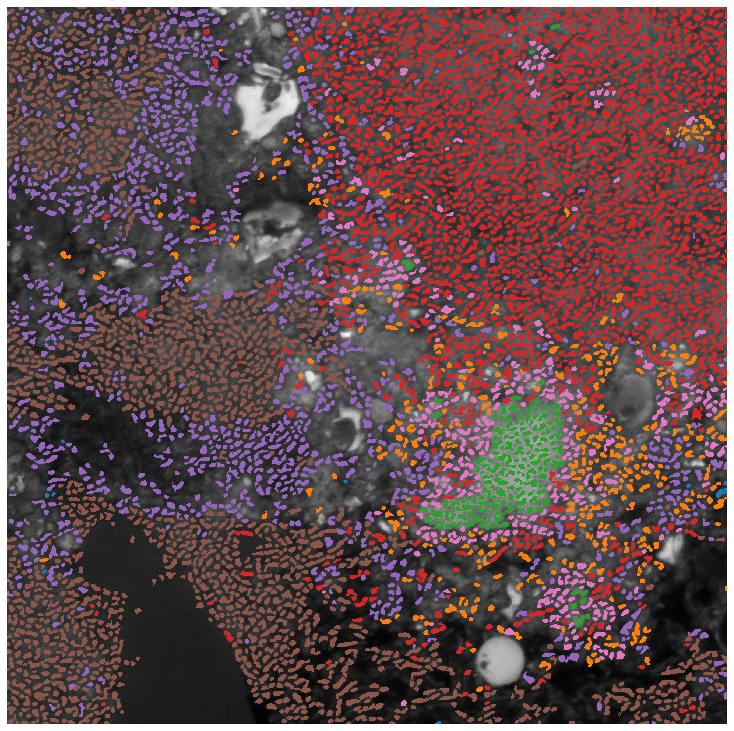

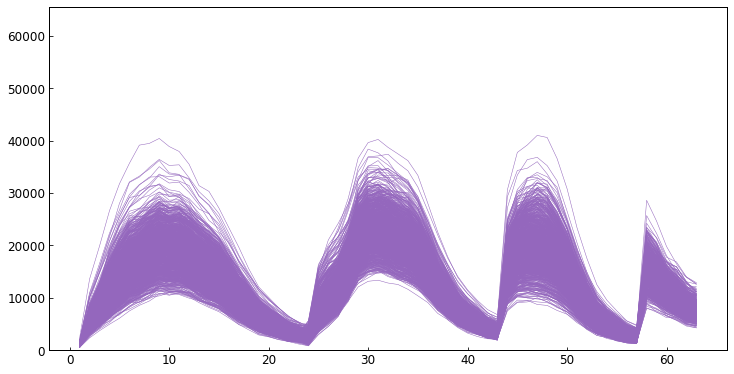

13


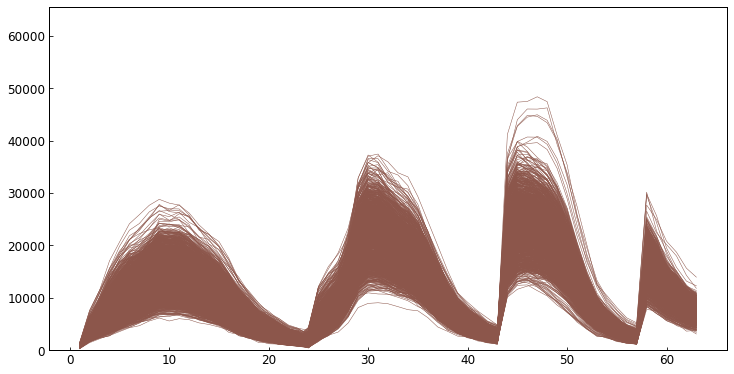

10


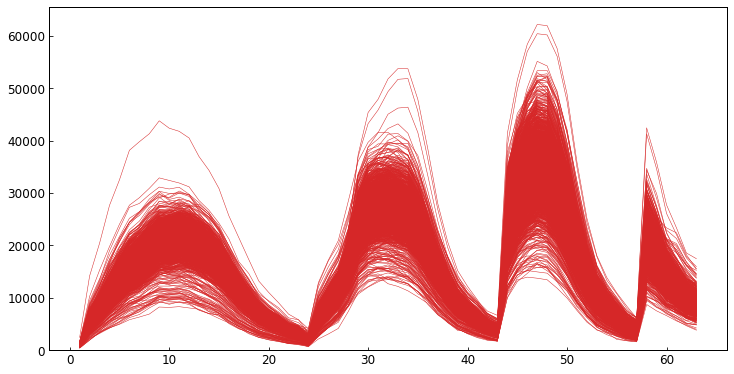

8


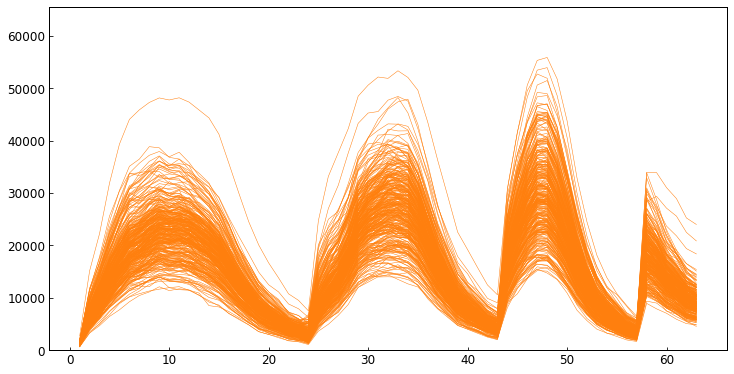

9


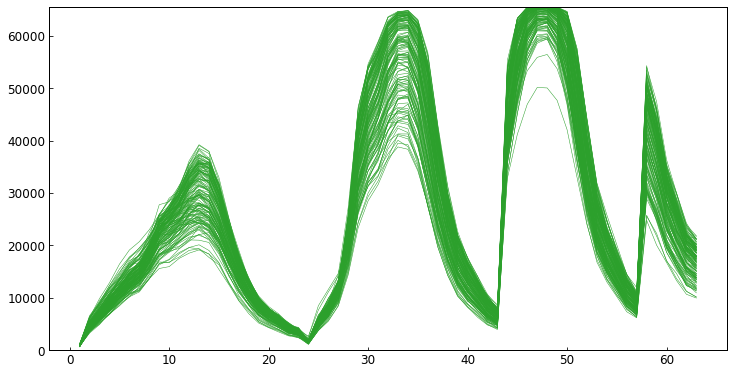

14


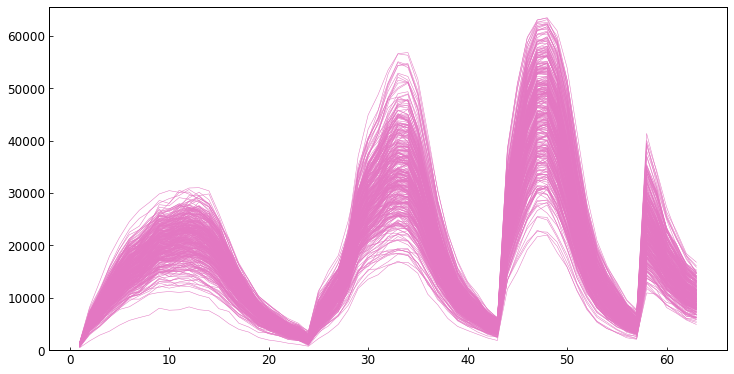

1


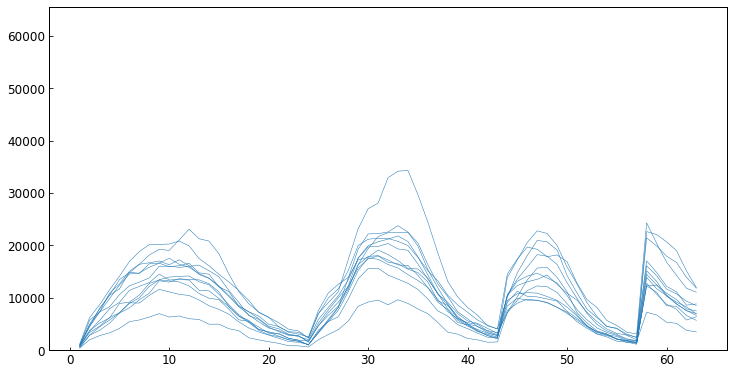

-------------------------------------


In [74]:
for m in Ms:
    print('----------Tile:', m,'--------------')
    stack = np.load(stack_fn.format(m=m))    
    props = pd.read_csv(props_fn.format(m=m))    
    seg = np.load(seg_fn.format(m=m))  


    with open(spec_fn.format(m=m), 'r') as f:
        dict_lab_spec = yaml.unsafe_load(f)
        # spec = yaml.load(f, Loader=Loader)
    with open(clust_fn.format(m=m), 'r') as f:
        dict_lab_clust = yaml.unsafe_load(f)


    imin = 10

    im_sum = np.sum(stack, axis=2)
    mx = np.max(im_sum)
    mn = np.min(im_sum)
    im_norm = (im_sum - mn) / (mx - mn)
    im_rgb = im_norm[:,:,None] * np.array([1,1,1])[None,:]
    fig, ax, cbar = ip.plot_image(im_rgb, im_inches=imin)
    # ip.plot_image(im_sum, cmap='gray', im_inches=imin)

    labels = list(dict_lab_clust.keys())

    colors = plt.get_cmap('tab10').colors
    clust_unq = np.unique(list(dict_lab_clust.values()))[1:]
    dict_clust_col = dict(zip(clust_unq, colors))

    im_rgb = im_norm[:,:,None] * np.array([1,1,1])[None,:]
    for i, row in props.iterrows():
        l = row.label
        if l in labels:
            b = row.bbox
            cl = dict_lab_clust[l]
            if cl:
                color = np.array(dict_clust_col[cl])
                b = eval(b) if isinstance(b, str) else b
                rgb_sub = im_rgb[b[0]:b[2],b[1]:b[3]]
                seg_sub = seg[b[0]:b[2],b[1]:b[3]] == l
                im_sub = im_norm[b[0]:b[2],b[1]:b[3]]
                rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*3)
                # rgb_cell = (im_sub * seg_sub)[:,:,None] * color[None,:]        
                rgb_cell = seg_sub[:,:,None] * color[None,:]
                im_rgb[b[0]:b[2],b[1]:b[3],:] = rgb_noncell + rgb_cell

    fig, ax, cbar = ip.plot_image(im_rgb, im_inches=10)


    dict_clust_spec = defaultdict(list)
    for l, cl in dict_lab_clust.items():
        if cl:
            dict_clust_spec[cl].append(dict_lab_spec[l])



    for cl, spec in dict_clust_spec.items():
        print(cl)
        fig, ax = ip.general_plot(dims=spec_dims)
        color = dict_clust_col[cl]
        spec_ = np.vstack(spec)
        fsi.plot_cell_spectra(ax, spec_, {'lw':0.5,'alpha':1,'color':color})
        ax.set_ylim(0,2**16)
        plt.plot()
        plt.show()


    print('-------------------------------------')


## Plot colors 

In [109]:
scinames_all = [v_ for v in dict_m_clust_sciname.values() for v_ in v.values() if v_]
scinames, counts = np.unique(scinames_all, return_counts=True)
scinames
# arrinds = counts.argsort()
# scinames_sort = scinames[arrinds[::-1]]
# counts_sort = counts[arrinds[::-1]]
# print(scinames_sort)
# print(counts_sort)
# colors = plt.get_cmap('tab10').colors
# dict_clust_col = dict(zip(clust_unq, colors))

# dict_sciname_color = 

array(['Actinomyces', 'Campylobacter', 'Fusobacterium', 'Neisseriaceae',
       'Pasteurellaceae', 'Porphyromonas', 'Prevotella', 'Rothia',
       'Streptococcus'], dtype='<U15')

In [114]:
scinames_sort = [
    'Actinomyces', 
    'Fusobacterium', 
    'Streptococcus',
    'Pasteurellaceae',
    'Porphyromonas', 
    'Campylobacter', 
    'Prevotella', 
    'Rothia', 
    'Neisseriaceae'
    ]

colors = plt.get_cmap('tab10').colors
dict_sciname_col = dict(zip(scinames_sort, colors))

In [118]:
classif_dir = output_dir + '/classif_plots'
if not os.path.exists(classif_dir): 
    os.makedirs(classif_dir)
    print("made dir", classif_dir)

bn = sn + '_M_{m}'

classif_bn = classif_dir + '/' + bn + '_classif'

In [122]:
imin = 10
resolution = 0.05990374007588672

dict_sciname_counts = defaultdict(lambda: 0)
# for m in [8]:
for m in Ms:
    out_bn = classif_bn.format(m=m)
    # if not os.path.exists(out_bn + '.png'):
    print('----------Tile:', m,'--------------')
    stack = np.load(stack_fn.format(m=m))    
    props = pd.read_csv(props_fn.format(m=m))    
    seg = np.load(seg_fn.format(m=m))  


    with open(spec_fn.format(m=m), 'r') as f:
        dict_lab_spec = yaml.unsafe_load(f)
        # spec = yaml.load(f, Loader=Loader)
    with open(clust_fn.format(m=m), 'r') as f:
        dict_lab_clust = yaml.unsafe_load(f)


    dict_clust_sciname = dict_m_clust_sciname[int(m)]


    im_sum = np.sum(stack, axis=2)
    mx = np.max(im_sum)
    mn = np.min(im_sum)
    im_norm = (im_sum - mn) / (mx - mn)
    im_rgb = im_norm[:,:,None] * np.array([1,1,1])[None,:]



    labels = list(dict_lab_clust.keys())
    im_rgb = im_norm[:,:,None] * np.array([1,1,1])[None,:]
    for i, row in props.iterrows():
        l = row.label
        if l in labels:
            b = row.bbox
            cl = dict_lab_clust[l]
            if cl:
                sciname = dict_clust_sciname[cl]
                if sciname:
                    dict_sciname_counts[sciname] += 1
    #                 color = np.array(dict_sciname_col[sciname])
    #                 b = eval(b) if isinstance(b, str) else b
    #                 rgb_sub = im_rgb[b[0]:b[2],b[1]:b[3]]
    #                 seg_sub = seg[b[0]:b[2],b[1]:b[3]] == l
    #                 im_sub = im_norm[b[0]:b[2],b[1]:b[3]]
    #                 rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*3)
    #                 # rgb_cell = (im_sub * seg_sub)[:,:,None] * color[None,:]        
    #                 rgb_cell = seg_sub[:,:,None] * color[None,:]
    #                 im_rgb[b[0]:b[2],b[1]:b[3],:] = rgb_noncell + rgb_cell

    # fig, ax, cbar = ip.plot_image(im_rgb, im_inches=10, scalebar_resolution=resolution)
    # ip.save_png_pdf(out_bn)


----------Tile: 0 --------------


----------Tile: 1 --------------
----------Tile: 2 --------------
----------Tile: 3 --------------
----------Tile: 4 --------------
----------Tile: 5 --------------
----------Tile: 6 --------------
----------Tile: 7 --------------
----------Tile: 8 --------------


In [105]:
m

'5'

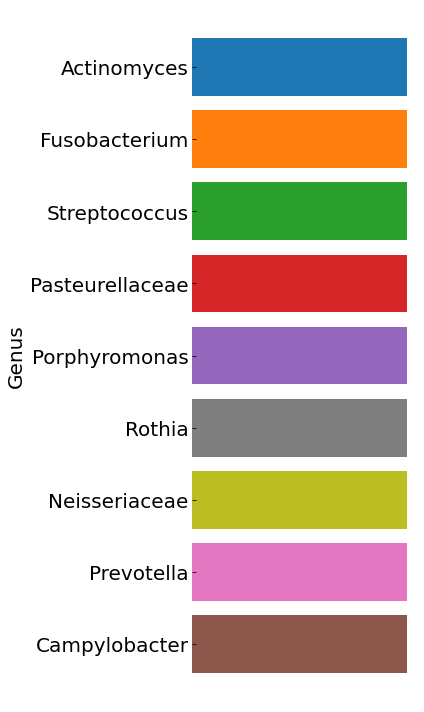

In [125]:
s_ = dict_sciname_counts.keys()
c_ = dict_sciname_counts.values()
cl_ = dict_sciname_col.values()

scinames_countsort = [x for _, x in sorted(zip(c_, s_))][::-1]
colors_countsort = [dict_sciname_col[sciname] for sciname in scinames_countsort]

ip.taxon_legend(scinames_countsort, colors_countsort)
ip.save_png_pdf(classif_dir + '/' + sn + '_taxon_legend')